

---


# DataSet
Customer Segmentation [link](https://www.kaggle.com/datasets/vetrirah/customer), contains

| Feature         | Description     | Values |
|--------------|-----------|------------|
| ID | Id of customer | 1,2,3,4,... |
| Gender | Gender of the customer  | (Male & Female) |
| Ever_Married |  Marital status of the customer | (Yes & No) |
| Age | Age of the customer | 10,20, 25, 40,.... |
| Graduated | Is the customer a graduate? | (Yes & No) | 
| Profession |Profession of the customer | (Artist, Healthcare,Doctor, Engineer, Lawyer, etc) |
| Work_Experience |  Work Experience |  (1:10) |
| Spending_Score | Spending score of the customer | (Low, Average, High) |
| Family_Size | Number of family members for the customer (including the customer)  | 1,5,2,.. |
| Var_1 | Variable  | (Cat_1, Cat_2, Cat_3, Cat_4) |

  ---


# Conclusion

*  **Dataset** is not distributed properly to the actual segments. i.e, there are poorly patterns.
*   Extracting information in the form of ***variations*** is useful for **ML** algorithms than original data. this appear in the performance of ***Classification Algorithms*** on the data that are clustered using **Principal Components** than that are clustered using Original Data points.

 * The First **Principal Component**, in most cases perform as the all **PCs**, especially in the **`KMeans`**. This means that many PCs are not always good. Because in the case of the **`KMeans`** causes conflict.

* **Clustering Techniques** **`KMeans Agglomerative DBSCAN GMM`** has been tried to cluster data better than the current situation.
the **KMeans & Agglomerative** give best results based on silhouette score.
**Classification Algorithms** **`KNN RF SVM AdaBoost`** were used to ensure that **KMeans & Agglomerative** work. The performance of **classification Algorithms** on `KMeans` was very high and no ***overfitting*** occurred except for `AdaBoost`. Either with Agglomerative, ***overfitting***  occurred.

* **TSNE** is used to visualize Data
---



# Import Libraries

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as py
import seaborn as sb

from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.mixture import GaussianMixture

from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier

from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, classification_report

# Load Data

In [4]:
trainSet = pd.read_csv('/kaggle/input/customer/Train.csv', index_col='ID')
trainCluster = trainSet['Segmentation']
trainSet.drop(['Segmentation'], axis=1, inplace=True)

testSet = pd.read_csv('/kaggle/input/customer/Test.csv', index_col='ID')
testCluser = pd.read_csv('/kaggle/input/customer/sample_submission.csv', index_col='ID')

# Some ***EDA*** on Data

## Information about Data

In [3]:
trainSet.head(10)

,Gender,Ever_Married,Age,Graduated,Profession,Work_Experience,Spending_Score,Family_Size,Var_1
ID,,,,,,,,,
462809,Male,No,22,No,Healthcare,1.0,Low,4.0,Cat_4
462643,Female,Yes,38,Yes,Engineer,NaN,Average,3.0,Cat_4
466315,Female,Yes,67,Yes,Engineer,1.0,Low,1.0,Cat_6
461735,Male,Yes,67,Yes,Lawyer,0.0,High,2.0,Cat_6
462669,Female,Yes,40,Yes,Entertainment,NaN,High,6.0,Cat_6
461319,Male,Yes,56,No,Artist,0.0,Average,2.0,Cat_6
460156,Male,No,32,Yes,Healthcare,1.0,Low,3.0,Cat_6
464347,Female,No,33,Yes,Healthcare,1.0,Low,3.0,Cat_6
465015,Female,Yes,61,Yes,Engineer,0.0,Low,3.0,Cat_7


In [4]:
trainSet.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8068 entries, 462809 to 461879
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Gender           8068 non-null   object 
 1   Ever_Married     7928 non-null   object 
 2   Age              8068 non-null   int64  
 3   Graduated        7990 non-null   object 
 4   Profession       7944 non-null   object 
 5   Work_Experience  7239 non-null   float64
 6   Spending_Score   8068 non-null   object 
 7   Family_Size      7733 non-null   float64
 8   Var_1            7992 non-null   object 
dtypes: float64(2), int64(1), object(6)
memory usage: 630.3+ KB


In [5]:
pd.DataFrame({'missing':trainSet.isnull().sum(), 
              'percentage':(trainSet.isnull().sum() / np.shape(trainSet)[0]) * 100})

,missing,percentage
Gender,0,0.000000
Ever_Married,140,1.735250
Age,0,0.000000
Graduated,78,0.966782
Profession,124,1.536936
Work_Experience,829,10.275161
Spending_Score,0,0.000000
Family_Size,335,4.152206
Var_1,76,0.941993


In [6]:
trainSet.describe()

,Age,Work_Experience,Family_Size
count,8068.000000,7239.000000,7733.000000
mean,43.466906,2.641663,2.850123
std,16.711696,3.406763,1.531413
min,18.000000,0.000000,1.000000
25%,30.000000,0.000000,2.000000
50%,40.000000,1.000000,3.000000
75%,53.000000,4.000000,4.000000
max,89.000000,14.000000,9.000000


from the description above the **age** is `right-skweed` this mean that the most customers are young.
because the `mean > median`

In [7]:
# Number of Unique Values
(len(np.unique(trainSet.Work_Experience)) - 1, len(np.unique(trainSet.Family_Size)) - 1)

(15, 9)

Deal with ***Work_Experience*** & ***Family_Size*** as **(ordinal) categorical** features, because the number of unique values is few.
It is make sense with the nature of these feature.

## Working with Features
Main Question, **Is there any combination of features that can distinguish between the Segments?**

In [5]:
def plot_category(categorical, contenious= trainSet.Age, target= trainCluster):
    """
    Make Some Visualizations
    :param categorical: categorical feature
    :param contenious: numerical feature that want to show its distribution.
    :param target: target feature to make hue
    :return: None
    """

    sb.set_theme(style='ticks')
    py.figure(figsize=(10, 5))
    py.title("Count of each value in " + categorical.name)
    sb.countplot(x=categorical, hue=target); py.show()

    sb.set_theme(style='darkgrid')
    # py.figure(figsize=(10, 5))
    # py.title("Distribution of " + contenious.name + " based on " + categorical.name)
    # sb.stripplot(x=categorical, y=contenious, hue=target); py.show()
    #
    # sb.set_theme(style='ticks')
    py.figure(figsize=(10, 5))
    py.title("Distribution of " + contenious.name + " based on " + categorical.name)
    sb.boxenplot(x=categorical, y=contenious, hue=target); py.show()

    pass

### Age

<AxesSubplot:xlabel='Age', ylabel='Density'>

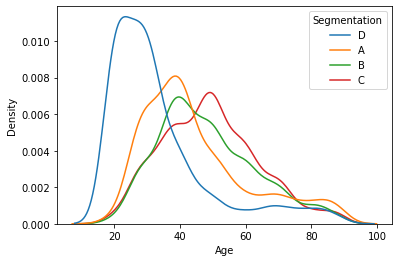

In [9]:
sb.kdeplot(x=trainSet['Age'], hue=trainCluster)

<AxesSubplot:xlabel='Age', ylabel='Count'>

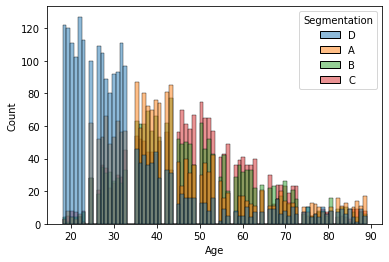

In [10]:
sb.histplot(x=trainSet['Age'], hue=trainCluster, bins=80)

In [11]:
pd.DataFrame(data=[trainCluster[(trainSet['Age'] >= 35) & (trainSet['Age'] <= 45)].value_counts(),
                   trainCluster[(trainSet['Age'] >= 35) & (trainSet['Age'] <= 45)].value_counts() / trainCluster[(trainSet['Age'] >= 35) &
                   (trainSet['Age'] <= 45)].value_counts().sum() * 100], index=['Segmentation', 'Percentage'])

,A,B,C,D
Segmentation,722.000000,621.000000,484.000000,346.000000
Percentage,33.225955,28.578003,22.273355,15.922688


> There are many overlaps between Segmentations. because of this, the **age** only not enough for describe behavior of customers.
i.e, can't distinguish between all ***Segments*** using this features.
But can distinguish the ***Segnment*** **D**, in case the **age** is small than ***25*** year.


### Gender

In [12]:
pd.DataFrame(data=[(trainCluster[(trainSet['Gender'] == 'Male')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Gender'] == 'Female')].value_counts()/ trainCluster.value_counts()) * 100],
             index=['Male', 'Female'])

,D,A,C,B
Male,57.716049,53.904665,53.19797,53.659849
Female,42.283951,46.095335,46.80203,46.340151


> In each Segment the Percentage(Distribution) of *males* and *female* is closer.

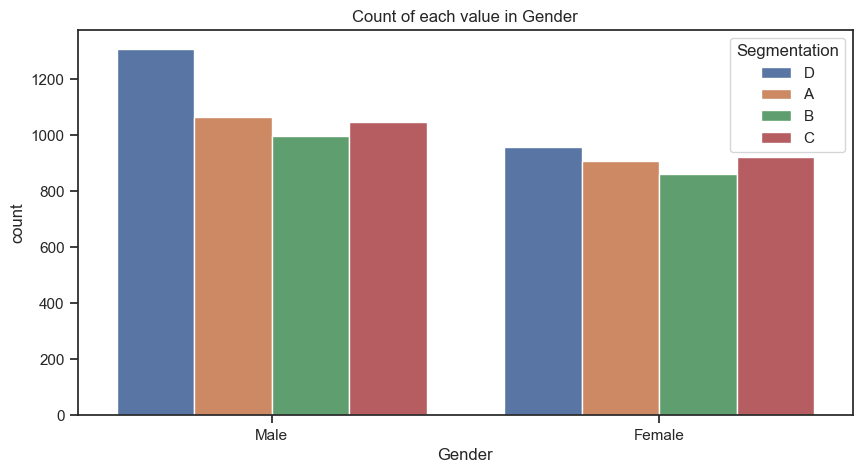

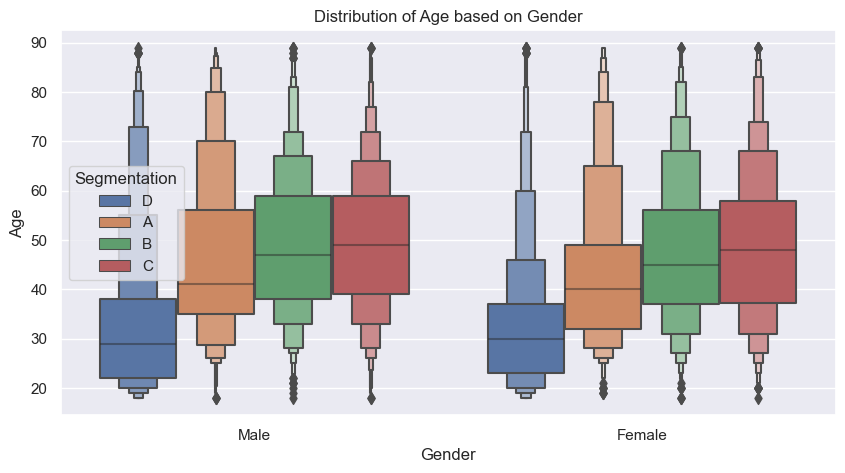

In [6]:
plot_category(categorical=trainSet.Gender)

> + From ***count plot*** the **Gender** can't distinguish between ***Segments*** 
> If Customer is *Male*, can't tell what's his ***Segments*** , because the count of each ***segment*** is closer.
> also in *Female*
> + From ***boxen plots***, The distribution of **age** for each **Gender** in each ***Segment*** is almost the same.
> Can't Solve Overlap problem in age. i.e, can't distinguish between ***Segment*** using these 2-features.

### Ever_Married

In [14]:
pd.DataFrame(data=[(trainCluster[(trainSet['Ever_Married'] == 'No')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Ever_Married'] == 'Yes')].value_counts()/ trainCluster.value_counts()) * 100],
             index=['Not Married', 'Married'])

,A,B,C,D
Not Married,40.618661,25.780409,20.203046,70.855379
Married,57.657201,72.551130,78.629442,26.851852


> In each Segment the Percentage(Distribution) of *married* and *not married, yet* is seperated well, except the segment ***A***.

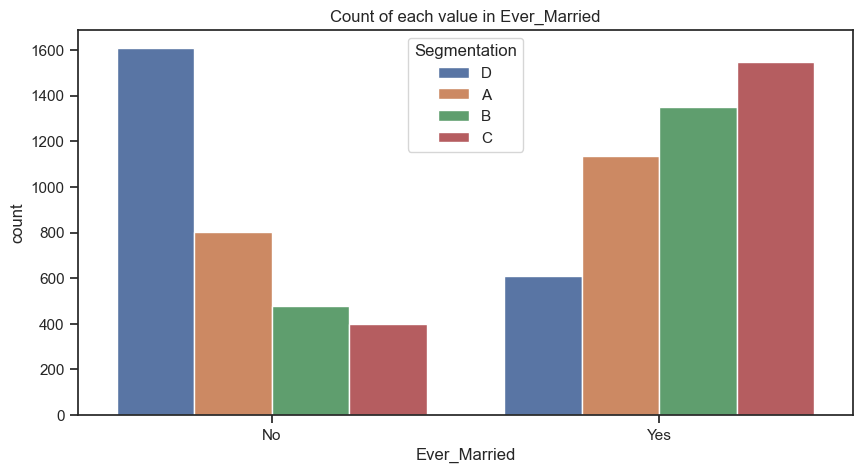

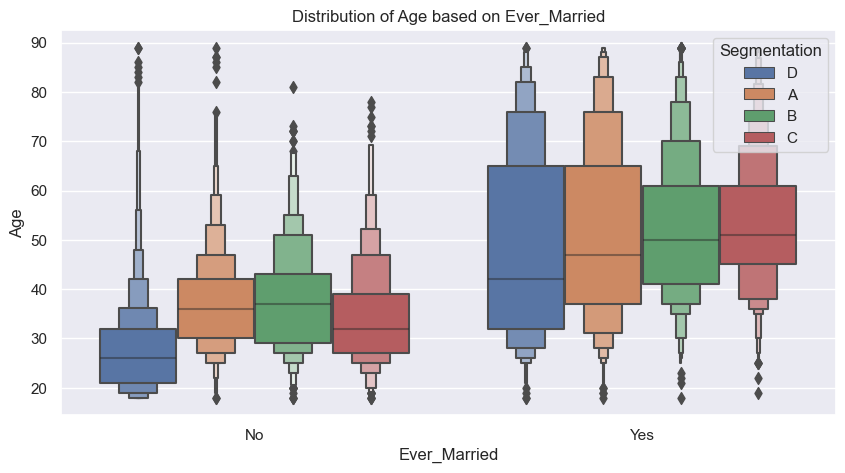

In [7]:
plot_category(categorical=trainSet.Ever_Married)

> + From ***count plot*** the **Gender** can distinguish between ***Segments*** only in case the customer is *not married*, where
the ***segment*** would be **D** because the count of in this ***segment*** is significantly far from the rest.
> but no in *Female*
> + From ***boxen plots*** The distribution of **age** for each **category** can't distinguish between ***Segments*** using these 2-features.

### Graduated

In [16]:
pd.DataFrame(data=[(trainCluster[(trainSet['Graduated'] == 'No')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Graduated'] == 'Yes')].value_counts()/ trainCluster.value_counts()) * 100],
             index=['Not Graduated', 'Graduated'])

,A,B,C,D
Not Graduated,36.967546,27.341227,17.664975,63.359788
Graduated,61.815416,71.689989,81.573604,35.714286


> In each Segment the Percentage(Distribution) of *graduated* and *not graduated, yet* is seperated well, especially in the segment ***C & B***.

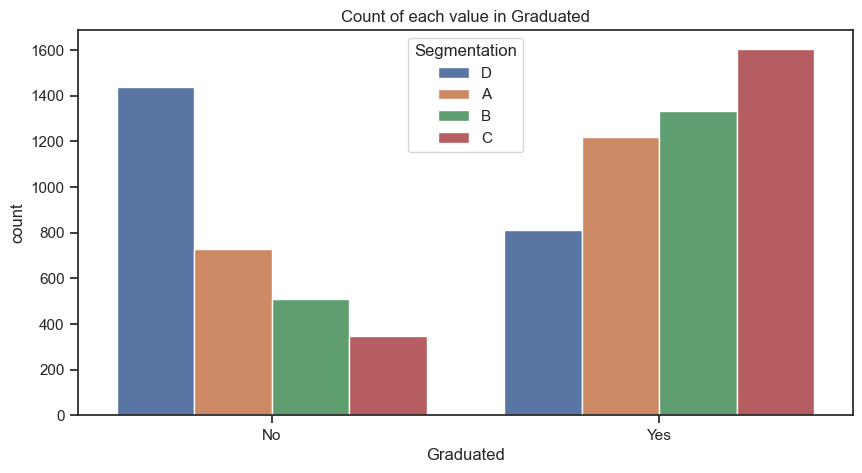

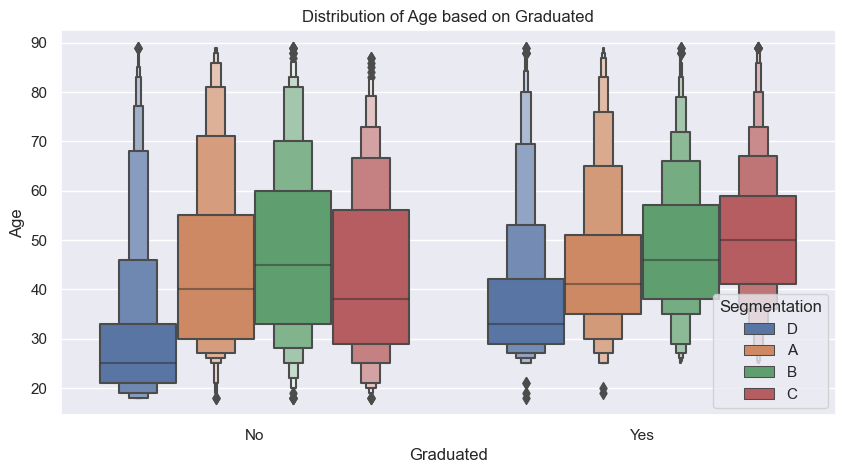

In [8]:
plot_category(categorical=trainSet.Graduated)

> + Form ***count plot*** the **Graduated** can distinguish between ***Segments*** only in case the customer is *not graduated*, where
the ***segment*** would be **D** because the count of in this ***segment*** is significantly far from the rest.
> but no in *Female*
> + From ***strip*** The distribution of **age** for each **category** can't distinguish between ***Segment*** using these 2-features.

### Profession

In [18]:
trainSet.Profession.unique()

array(['Healthcare', 'Engineer', 'Lawyer', 'Entertainment', 'Artist',
       'Executive', 'Doctor', 'Homemaker', 'Marketing', nan], dtype=object)

In [19]:
pd.DataFrame(data=[(trainCluster[(trainSet['Profession'] == 'Healthcare')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Engineer')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Lawyer')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Entertainment')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Artist')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Executive')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Doctor')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Homemaker')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Profession'] == 'Marketing')].value_counts()/ trainCluster.value_counts()) * 100],
             index=trainSet.Profession.unique()[:-1])

,A,B,C,D
Healthcare,5.375254,5.435953,7.411168,43.165785
Engineer,13.133874,10.172228,3.807107,7.760141
Lawyer,9.989858,8.503767,7.106599,5.643739
Entertainment,18.509128,11.894510,7.512690,9.479718
Artist,28.296146,40.688913,54.060914,6.040564
Executive,6.338742,9.849300,8.883249,5.114638
Doctor,10.091278,7.696448,7.106599,9.082892
Homemaker,3.701826,2.960172,1.421320,3.968254
Marketing,2.890467,1.614639,1.776650,7.495591


> In segment ***A & B & C***, the dominant profession is **Artist**.
>
> But in segment ***D***, the dominant profession is **Healthcar**. 

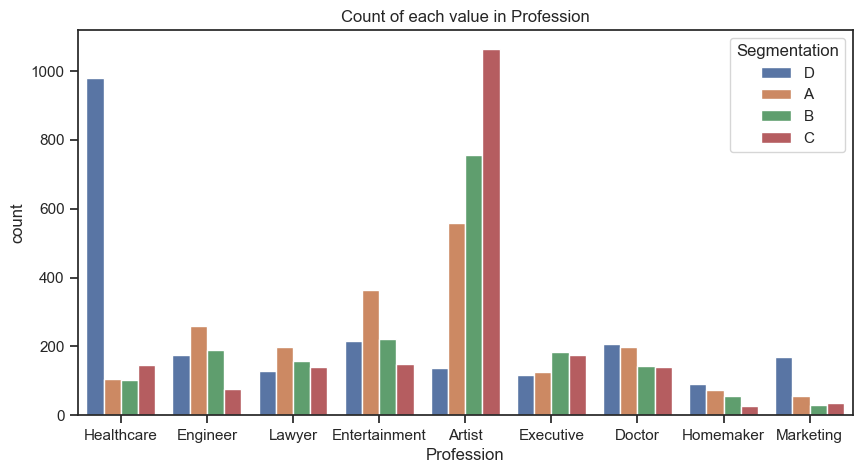

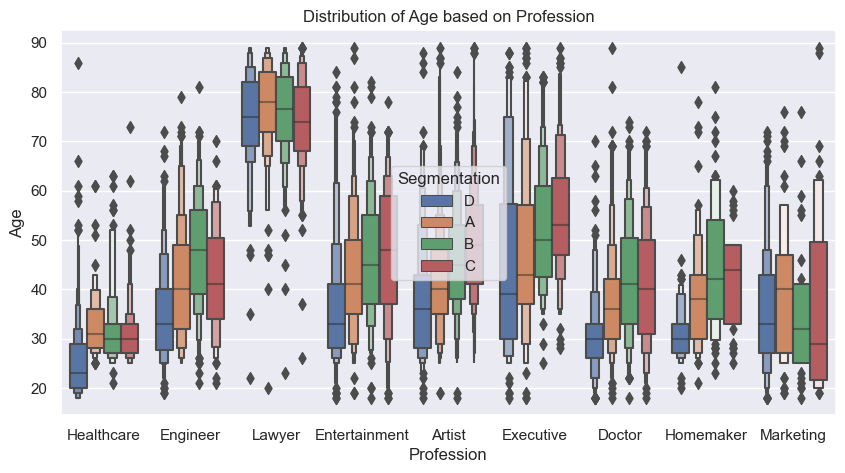

In [9]:
plot_category(categorical=trainSet.Profession)

> + Form ***count plot***, the **Profession** can distinguish between many ***Segments***, in case the **Profession** is
>> *Healthcare* then the ***Segments*** should be **D**
>>
>> *Artist* then the ***Segments*** should be **C**
>>
>> *Marketng* then the ***Segments*** may be **D**
>>
>> *Entertainment* then the ***Segments*** should be **A**
> + From ***boxen plots***, the small **age** values `less than 25` and *Healthcare* **Profession**, the segment is **D**, but in high **age** values not and can't distinguish between ***Segments***.
 *Layer* **Profession** has diffrient pattern than other **Profession**, thier **age** is high.  

### Work Experience

In [21]:
trainSet.Work_Experience.unique()

array([ 1., nan,  0.,  4.,  9., 12.,  3., 13.,  5.,  8., 14.,  7.,  2.,
        6., 10., 11.])

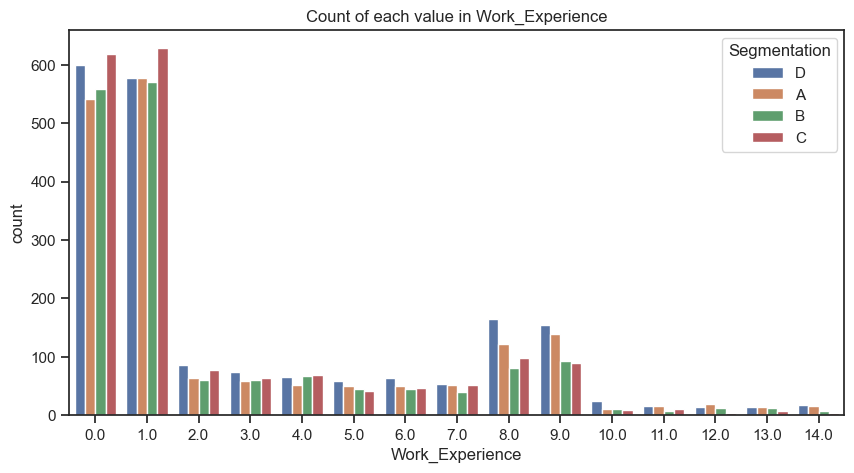

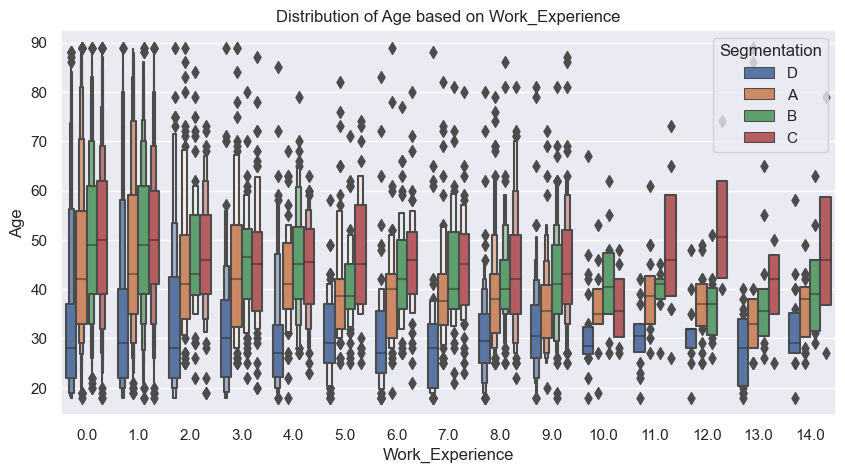

In [10]:
plot_category(categorical=trainSet.Work_Experience)

> + Form ***count plot***, the **Work Experience** can't distinguish between ***Segments***
> + From ***boxen plot***, when **Work Experience** is `11 12 13 14` and **age** is high the **segment** is **C**. but in other **Work Experience** can't distinguish.

### Spending Score

In [23]:
trainSet.Spending_Score.unique()

array(['Low', 'Average', 'High'], dtype=object)

In [24]:
pd.DataFrame(data=[(trainCluster[(trainSet['Spending_Score'] == 'Low')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Spending_Score'] == 'Average')].value_counts()/ trainCluster.value_counts()) * 100,
                   (trainCluster[(trainSet['Spending_Score'] == 'High')].value_counts()/ trainCluster.value_counts()) * 100],
             index=trainSet.Spending_Score.unique())

,A,B,C,D
Low,68.864097,47.578041,33.604061,87.037037
Average,17.393509,31.754575,45.837563,6.084656
High,13.742394,20.667384,20.558376,6.878307


> In segment ***D & A***, the dominant Spending Score is **Low**.

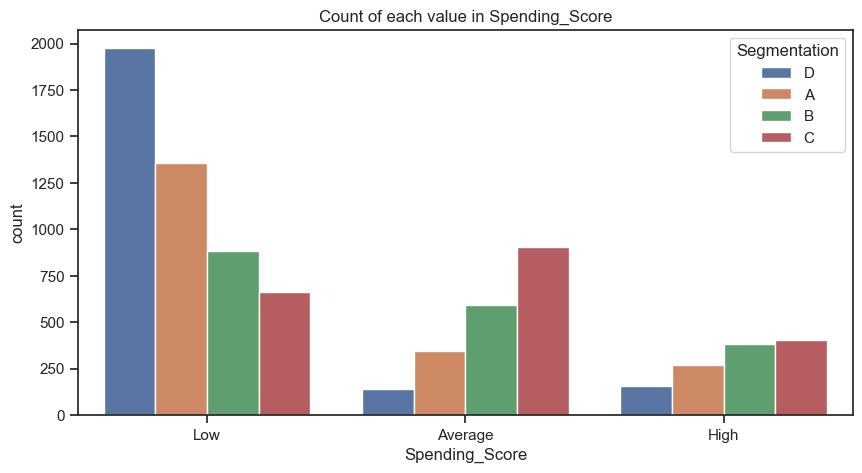

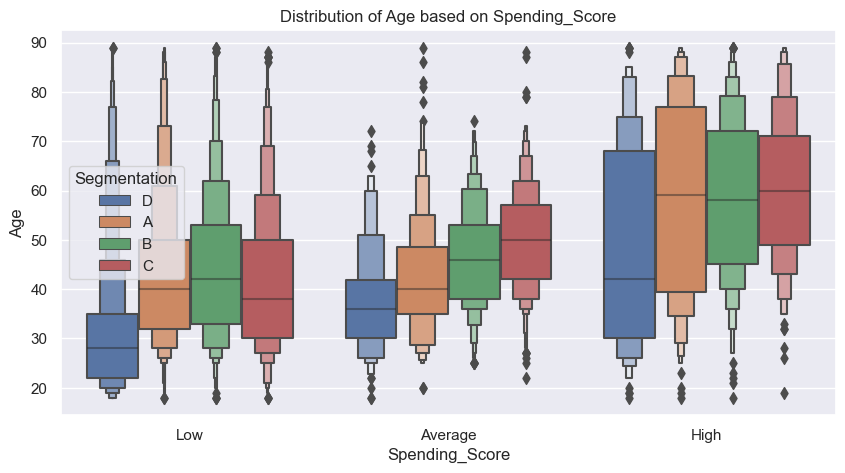

In [11]:
plot_category(categorical=trainSet.Spending_Score)

> + Form ***count plot***, the **Profession** can distinguish between many ***Segments***, in case the **Spending Score** is
>> *Low* then the ***Segments*** should be **D**
>>
>> *Average* then the ***Segments*** should be **C**
> + From ***boxen plot*** The distribution of **age** for each **category** can't distinguish between ***Segment*** using these 2-features.

### Family Size

In [26]:
trainSet.Family_Size.unique()

array([ 4.,  3.,  1.,  2.,  6., nan,  5.,  8.,  7.,  9.])

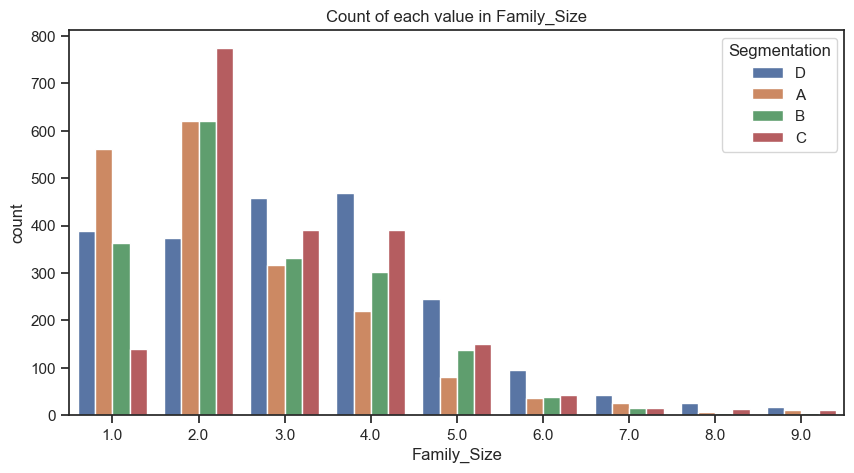

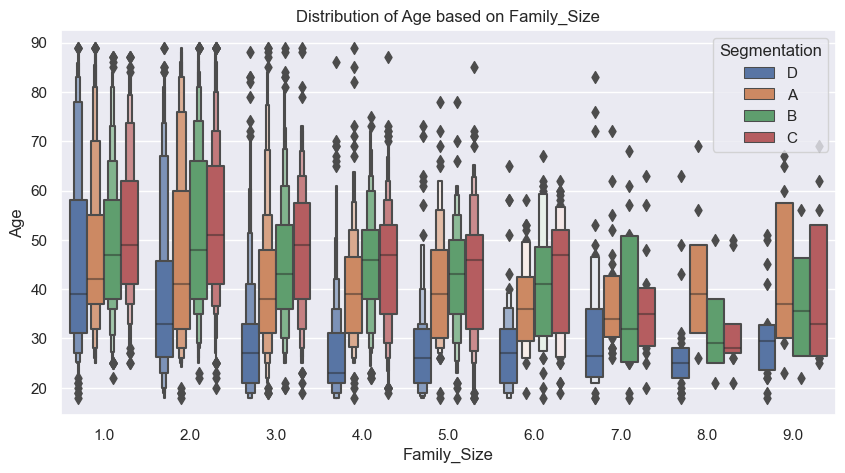

In [12]:
plot_category(categorical=trainSet.Family_Size)

> + Form ***count plot***, the **Profession** can distinguish between many ***Segments***, in case the **Family Size** is
>> *1* then the ***Segments*** should be **A**
>>
>> *2* then the ***Segments*** should be **C**
> + From ***boxen plot*** The distribution of **age** for each **category** can't distinguish between ***Segment*** using these 2-features.

### Var1

In [28]:
trainSet.Var_1.unique()

array(['Cat_4', 'Cat_6', 'Cat_7', 'Cat_3', 'Cat_1', 'Cat_2', nan, 'Cat_5'],
      dtype=object)

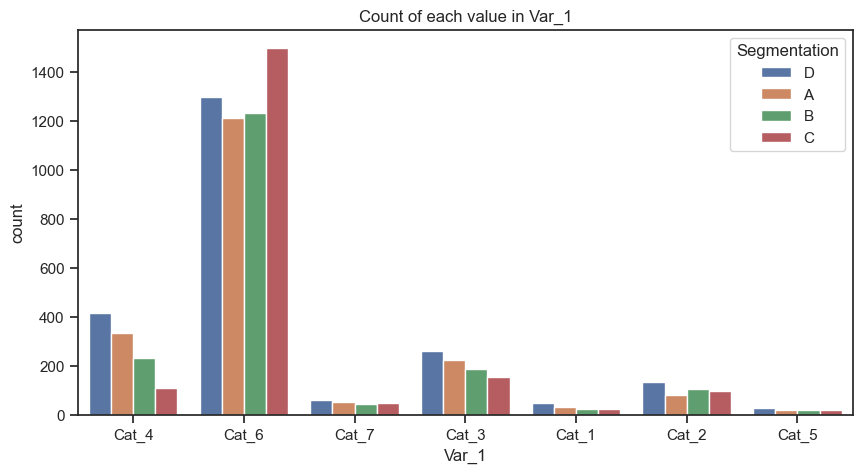

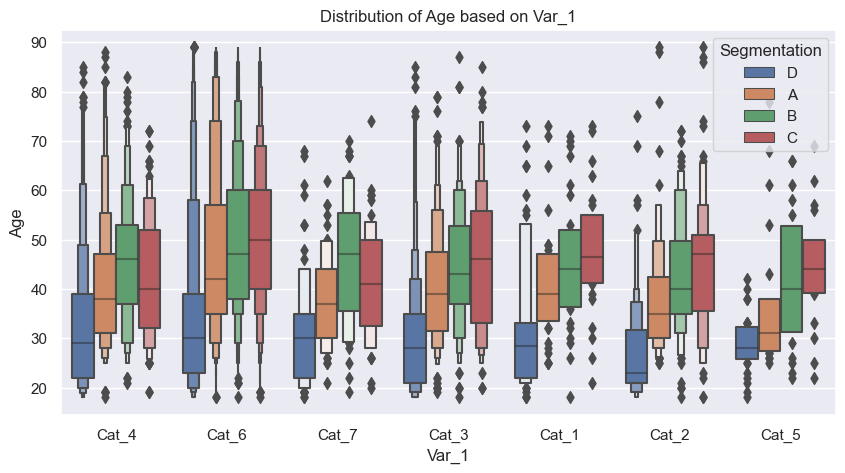

In [13]:
plot_category(categorical=trainSet.Var_1)

> + Form ***count plot***, the **Var 1** can't distinguish between ***Segments***
> + From ***boxen plot*** The distribution of **age** for each **category** can't distinguish between ***Segments*** using these 2-features.

## Observation
the Features that use to train model are 
* Ever Married
* Graduated
* Profession
* Spending_Score
* Family_Size
* Age
These feature can distinguish the **Segment D** quite clearly.

# Preprocessing

In [30]:
trainSet = trainSet.loc[:, ['Ever_Married', 'Graduated', 'Profession', 'Spending_Score', 'Family_Size', 'Age']]
testSet = testSet.loc[:, ['Ever_Married', 'Graduated', 'Profession', 'Spending_Score', 'Family_Size', 'Age']]

In [31]:
trainSet.head()

,Ever_Married,Graduated,Profession,Spending_Score,Family_Size,Age
ID,,,,,,
462809,No,No,Healthcare,Low,4.0,22
462643,Yes,Yes,Engineer,Average,3.0,38
466315,Yes,Yes,Engineer,Low,1.0,67
461735,Yes,Yes,Lawyer,High,2.0,67
462669,Yes,Yes,Entertainment,High,6.0,40


## Handle Missing Values

In [32]:
trainSet.isnull().sum()

Ever_Married      140
Graduated          78
Profession        124
Spending_Score      0
Family_Size       335
Age                 0
dtype: int64

In [33]:
testSet.isnull().sum()

Ever_Married       50
Graduated          24
Profession         38
Spending_Score      0
Family_Size       113
Age                 0
dtype: int64

### Further Analysis

In [34]:
trainSet.groupby(['Ever_Married']).Graduated.value_counts()

Ever_Married  Graduated
No            Yes          1662
              No           1592
Yes           Yes          3240
              No           1360
Name: Graduated, dtype: int64

the most **Married**  customers are **graduated** ***70.43%***

In [35]:
trainSet.groupby(['Spending_Score']).Graduated.value_counts()

Spending_Score  Graduated
Average         Yes          1450
                No            503
High            Yes           780
                No            425
Low             Yes          2738
                No           2094
Name: Graduated, dtype: int64

the most **Average** Spending Scores are **graduated** ***74.24%***

In [ ]:
# Handle Graduated
trainSet['Graduated'][(trainSet['Graduated'].isnull()) &  (trainSet['Spending_Score'] == 'Average')] = 'Yes'
trainSet['Graduated'][(trainSet['Graduated'].isnull())] = 'No'

testSet['Graduated'][(testSet['Graduated'].isnull()) &  (testSet['Spending_Score'] == 'Average')] = 'Yes'
testSet['Graduated'][(testSet['Graduated'].isnull())] = 'No'

In [37]:
trainSet.groupby(['Spending_Score']).Family_Size.value_counts()

Spending_Score  Family_Size
Average         2.0             813
                3.0             451
                4.0             434
                5.0             164
                6.0              47
                7.0              14
                1.0               7
                9.0               7
                8.0               6
High            2.0             585
                3.0             230
                4.0             213
                5.0              88
                6.0              25
                1.0              17
                7.0              12
                9.0              11
                8.0               6
Low             1.0            1429
                2.0             992
                3.0             816
                4.0             732
                5.0             360
                6.0             140
                7.0              70
                8.0              38
                9.0              26


In [38]:
trainSet.groupby(['Ever_Married']).Family_Size.value_counts()

Ever_Married  Family_Size
No            1.0             858
              3.0             630
              4.0             608
              2.0             453
              5.0             315
              6.0             120
              7.0              59
              8.0              36
              9.0              22
Yes           2.0            1909
              3.0             834
              4.0             749
              1.0             571
              5.0             284
              6.0              87
              7.0              36
              9.0              22
              8.0              12
Name: Family_Size, dtype: int64

In [ ]:
# Handle Family Size
trainSet['Family_Size'][(trainSet['Family_Size'].isnull()) & (trainSet['Spending_Score'] == 'High')] = 2
trainSet['Family_Size'][(trainSet['Family_Size'].isnull()) & (trainSet['Ever_Married'] == 'Yes')] = 2
trainSet['Family_Size'][(trainSet['Family_Size'].isnull()) & (trainSet['Spending_Score'] == 'Low')] = 1

testSet['Family_Size'][(testSet['Family_Size'].isnull()) & (testSet['Spending_Score'] == 'High')] = 2
testSet['Family_Size'][(testSet['Family_Size'].isnull()) & (testSet['Ever_Married'] == 'Yes')] = 2
testSet['Family_Size'][(testSet['Family_Size'].isnull()) & (testSet['Spending_Score'] == 'Low')] = 1

In [40]:
trainSet.groupby(['Ever_Married']).Profession.value_counts()

Ever_Married  Profession   
No            Healthcare       1153
              Artist            713
              Doctor            366
              Entertainment     358
              Engineer          267
              Marketing         189
              Homemaker         112
              Lawyer             40
              Executive          37
Yes           Artist           1774
              Entertainment     579
              Lawyer            575
              Executive         550
              Engineer          415
              Doctor            311
              Healthcare        145
              Homemaker         128
              Marketing          96
Name: Profession, dtype: int64

In [41]:
trainSet.groupby(['Spending_Score']).Profession.value_counts()

Spending_Score  Profession   
Average         Artist           1011
                Entertainment     319
                Engineer          221
                Doctor            177
                Executive          75
                Homemaker          60
                Healthcare         42
                Lawyer             18
                Marketing          17
High            Executive         398
                Lawyer            324
                Artist            242
                Engineer           60
                Entertainment      46
                Healthcare         45
                Marketing          33
                Doctor             31
                Homemaker          26
Low             Artist           1263
                Healthcare       1245
                Entertainment     584
                Doctor            480
                Engineer          418
                Lawyer            281
                Marketing         242
                Home

In [ ]:
# Handle Profession
trainSet['Profession'][(trainSet['Profession'].isnull()) & ((trainSet['Ever_Married'] == 'Yes') | (trainSet['Spending_Score'] == 'Average'))] = 'Artist'
trainSet['Profession'][(trainSet['Profession'].isnull()) & (trainSet['Ever_Married'] == 'No')] = 'Healthcare'
trainSet['Profession'][(trainSet['Profession'].isnull()) & (trainSet['Spending_Score'] == 'High')] = 'Executive'

testSet['Profession'][(testSet['Profession'].isnull()) & ((testSet['Ever_Married'] == 'Yes') | (testSet['Spending_Score'] == 'Average'))] = 'Artist'
testSet['Profession'][(testSet['Profession'].isnull()) & (testSet['Ever_Married'] == 'No')] = 'Healthcare'
testSet['Profession'][(testSet['Profession'].isnull()) & (testSet['Spending_Score'] == 'High')] = 'Executive'

In [43]:
# Handle Ever Married
trainSet['Ever_Married'].replace(np.nan, trainSet['Ever_Married'].mode()[0], inplace=True)
testSet['Ever_Married'].replace(np.nan, testSet['Ever_Married'].mode()[0], inplace=True)

In [44]:
trainSet.isnull().sum()

Ever_Married      0
Graduated         0
Profession        0
Spending_Score    0
Family_Size       0
Age               0
dtype: int64

In [45]:
testSet.isnull().sum()

Ever_Married      0
Graduated         0
Profession        0
Spending_Score    0
Family_Size       0
Age               0
dtype: int64

## Encoding

In [46]:
trainSet = pd.get_dummies(trainSet, columns=['Ever_Married', 'Graduated', 'Profession'], drop_first=True)
trainSet['Spending_Score'].replace(['Low', 'Average', 'High'], [0,1,2], inplace=True)

testSet = pd.get_dummies(testSet, columns=['Ever_Married', 'Graduated', 'Profession'], drop_first=True)
testSet['Spending_Score'].replace(['Low', 'Average', 'High'], [0,1,2], inplace=True)

In [47]:
trainCluster.replace(['A', 'B', 'C', 'D'], [0,1,2, 3], inplace=True)
testCluser.replace(['A', 'B', 'C', 'D'], [0,1,2, 3], inplace=True)

In [48]:
trainSet.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8068 entries, 462809 to 461879
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Spending_Score            8068 non-null   int64  
 1   Family_Size               8068 non-null   float64
 2   Age                       8068 non-null   int64  
 3   Ever_Married_Yes          8068 non-null   uint8  
 4   Graduated_Yes             8068 non-null   uint8  
 5   Profession_Doctor         8068 non-null   uint8  
 6   Profession_Engineer       8068 non-null   uint8  
 7   Profession_Entertainment  8068 non-null   uint8  
 8   Profession_Executive      8068 non-null   uint8  
 9   Profession_Healthcare     8068 non-null   uint8  
 10  Profession_Homemaker      8068 non-null   uint8  
 11  Profession_Lawyer         8068 non-null   uint8  
 12  Profession_Marketing      8068 non-null   uint8  
dtypes: float64(1), int64(2), uint8(10)
memory usage: 589.0 K

# Correlations

<Figure size 1080x360 with 0 Axes>

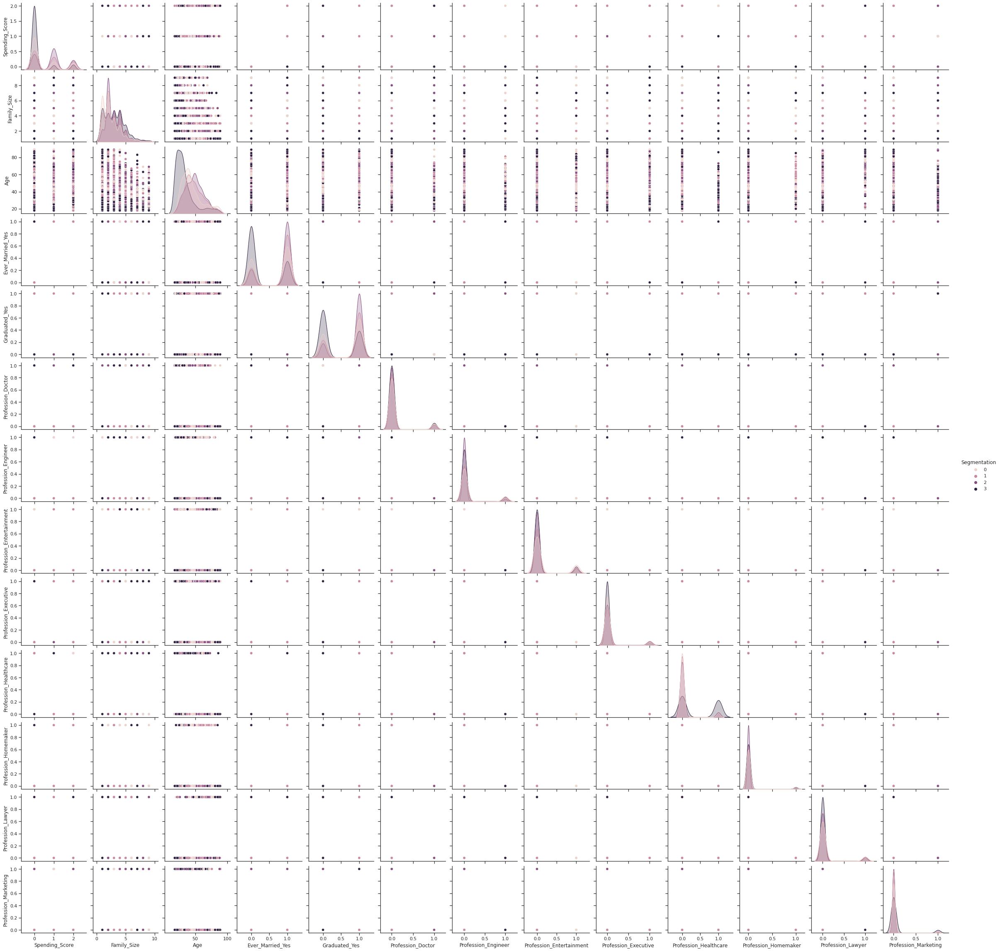

In [49]:
py.figure(figsize=(15,5))
sb.pairplot(data=pd.concat([trainSet, trainCluster], axis=1), hue="Segmentation")

<AxesSubplot:>

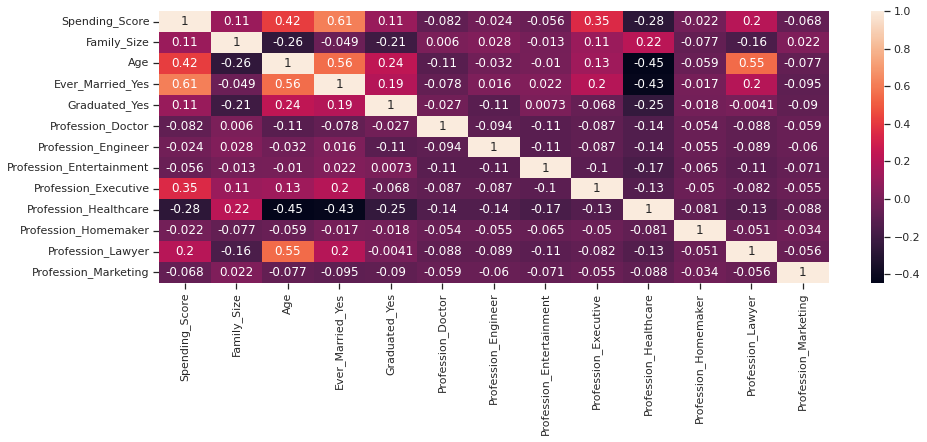

In [50]:
py.figure(figsize=(15,5))
sb.heatmap(trainSet.corr(), annot=True)

Not found multicollinearity

# Models

In [51]:
random_state = 45
max_itr = 500

## Clustering Models

In [52]:
def kmean(trainset=trainSet, actualClusters=trainCluster, testset=testSet, testClusters=testCluser, type_='k-means++',  clusters=4):
    """
    Run Kmean on the dataset
    :param trainset: Train DataSet
    :param actualClusters: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClusters: The actual segmentations in testing set
    :param type_: type of initiation of KMeans, ('random' | 'k-means++')
    :param clusters: number of clusters that KMeans groups the data to them
    :return: predicted labels of  training set, predicted labels of  testng set 
    """
    model = KMeans(n_clusters=clusters, init=type_, random_state=random_state, max_iter=max_itr)
    model.fit(trainset)
    preds = model.predict(trainset)
    preds_test = model.predict(testset)
    
    print("silhouette score Train =", silhouette_score(trainset, preds))
    print("silhouette score Test = ", silhouette_score(testset, preds_test))
    return preds, preds_test
def gaussian(trainset=trainSet, actualClusters=trainCluster, testset=testSet, testClusters=testCluser,  clusters=4):
    """
    Run Gaussian Mixture Model on the dataset
    :param trainset: Train DataSet
    :param actualClusters: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClusters: The actual segmentations in testing set
    :param clusters: number of clusters that KMeans groups the data to them
    :return: predicted labels of  training set, predicted labels of  testng set
    """
    model = GaussianMixture(n_components=clusters)
    model.fit(trainset)
    preds = model.predict(trainset)
    preds_test = model.predict(testset)

    print("silhouette score Train =", silhouette_score(trainset, preds))
    print("silhouette score Test = ", silhouette_score(testset, preds_test))
    return preds, preds_test
def agglomer(trainset=trainSet, actualClusters=trainCluster, testset=testSet, testClusters=testCluser,  clusters=4):
    """
    Run Agglomerative Clustering on the dataset
    :param trainset: Train DataSet
    :param actualClusters: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClusters: The actual segmentations in testing set
    :param clusters: number of clusters that KMeans groups the data to them
    :return: predicted labels of  training set, predicted labels of  testng set
    """

    # select the best linkage
    preds, preds_test = [], []
    linkage = ['ward', 'complete', 'average', 'single']
    for link in linkage:
      model = AgglomerativeClustering(n_clusters=4, linkage=link)

      preds.append(model.fit_predict(trainset))
      preds_test.append(model.fit_predict(testset))

      print("Linkage is : ", link, end='\n\t')
      print("silhouette score Train =", silhouette_score(trainset, preds[-1]))
      print("\tsilhouette score Test = ", silhouette_score(testset, preds_test[-1]), end='\n'+'++++++++'*5+'\n')

    return preds, preds_test
def dbscan(trainset=trainSet, actualClusters=trainCluster, testset=testSet, testClusters=testCluser,  clusters=4):
    """
    Run DBSCAN on the dataset
    :param trainset: Train DataSet
    :param actualClusters: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClusters: The actual segmentations in testing set
    :param clusters: number of clusters that KMeans groups the data to them
    :return: predicted labels of  training set, predicted labels of  testng set
    """
    model = DBSCAN()
    preds = model.fit_predict(trainset)
    preds_test = model.fit_predict(testset)

    print("silhouette score Train =", silhouette_score(trainset, preds))
    print("silhouette score Test = ", silhouette_score(testset, preds_test))
    return preds, preds_test

### On Original Data

In [56]:
preds_train_or, preds_test_or = kmean()

silhouette score Train = 0.508249092499952
silhouette score Test =  0.5059655533603914


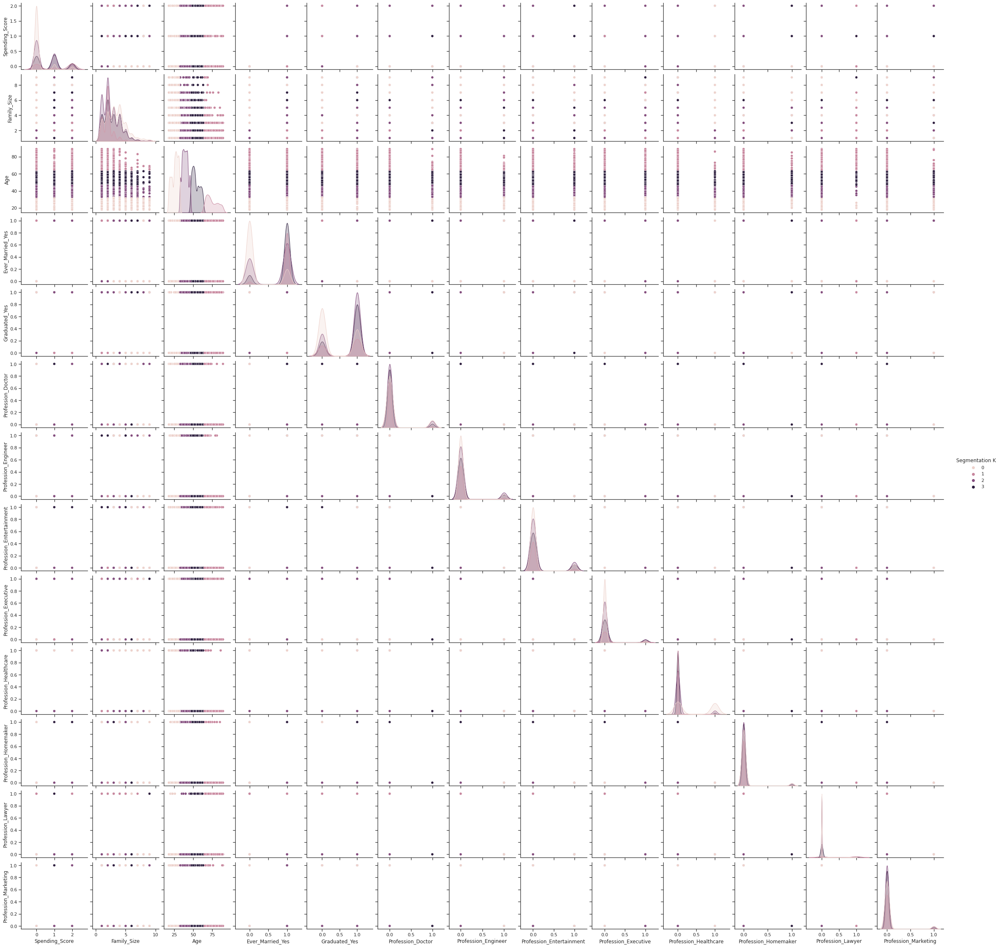

In [57]:
sb.pairplot(data=pd.concat([trainSet, pd.Series(data=preds_train_or, name='Segmentation K', index= trainSet.index)], axis=1),  hue='Segmentation K')

The **Kmeans** splits the data in good way

In [58]:
preds_train_agg, preds_test_agg = agglomer()

Linkage is :  ward
	silhouette score Train = 0.4441552848681571
	silhouette score Test =  0.4800796408326282
++++++++++++++++++++++++++++++++++++++++
Linkage is :  complete
	silhouette score Train = 0.49983299124435604
	silhouette score Test =  0.4910083132161949
++++++++++++++++++++++++++++++++++++++++
Linkage is :  average
	silhouette score Train = 0.5112964645103685
	silhouette score Test =  0.5279422762843956
++++++++++++++++++++++++++++++++++++++++
Linkage is :  single
	silhouette score Train = -0.3434842728241961
	silhouette score Test =  -0.31452544691557366
++++++++++++++++++++++++++++++++++++++++


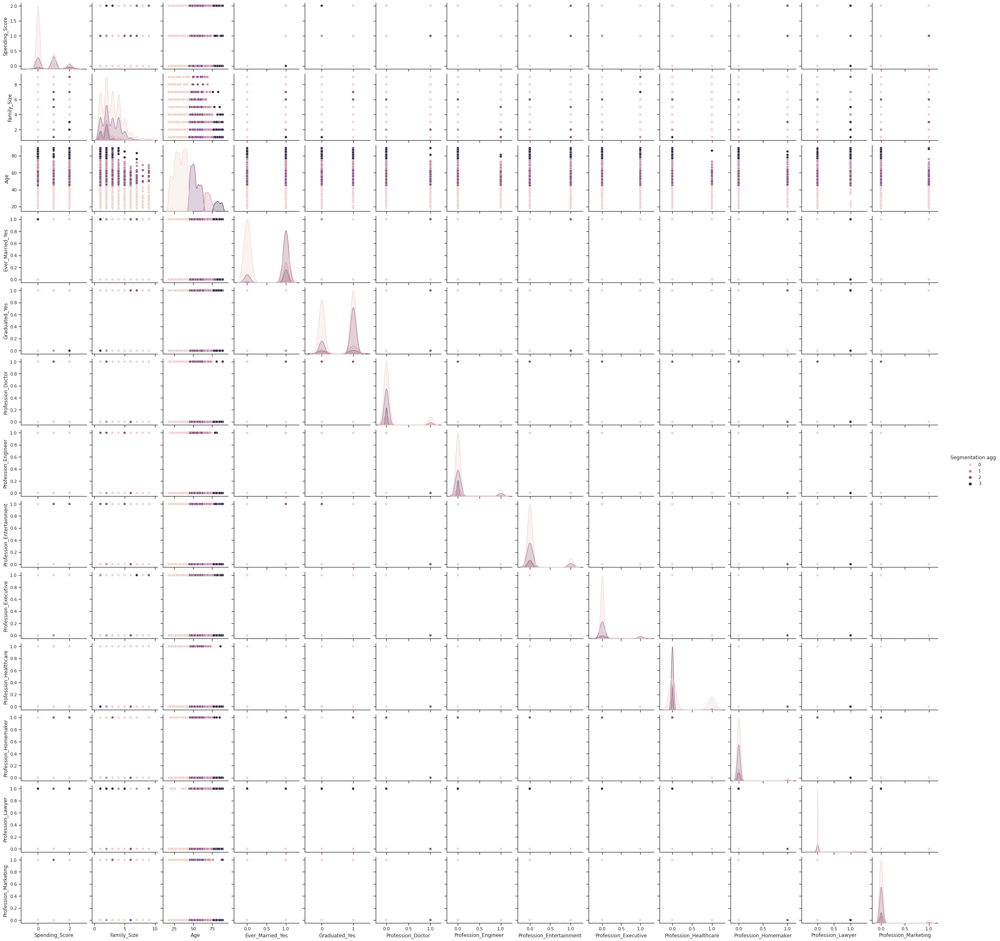

In [59]:
preds_train_agg, preds_test_agg = preds_train_agg[2], preds_test_agg[2]
sb.pairplot(data=pd.concat([trainSet, pd.Series(data=preds_train_agg, name='Segmentation agg',
                                               index= trainSet.index)], axis=1),  hue='Segmentation agg')

**Agglomerative** Clustering performs in good way, only when *linkage* is **average**. the silhouette score is ***0.51***


In [60]:
gaussian()

silhouette score Train = -0.03419296530373874
silhouette score Test =  -0.030309736015962235


(array([0, 3, 3, ..., 0, 0, 2]), array([3, 0, 2, ..., 3, 2, 0]))

silhouette score is **0.007** this maen that **GMM** make clustering in random way

In [61]:
dbscan()

silhouette score Train = -0.20743967600834973
silhouette score Test =  -0.583195819803789


(array([  0,  -1,  -1, ..., 142,  10,  -1]),
 array([-1, -1, -1, ..., -1, -1, -1]))

**DBSCAN** performs in bad way.


#### Apply TSNA

In [62]:
tsne = TSNE(random_state=random_state, init='pca')

In [ ]:
low_dim_tsne = pd.DataFrame(tsne.fit_transform(trainSet))
low_dim_tsne['Segmentation KMeans'] = preds_train_or
low_dim_tsne['Segmentation Agg'] = preds_train_agg

In [ ]:
low_dim_tsne_test = pd.DataFrame(tsne.fit_transform(testSet))
low_dim_tsne_test['Segmentation KMeans'] = preds_test_or
low_dim_tsne_test['Segmentation Agg'] = preds_test_agg

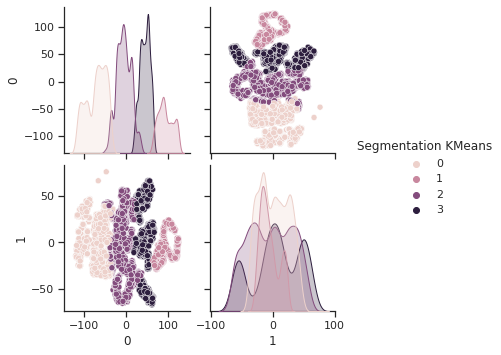

In [65]:
sb.pairplot(data=low_dim_tsne.loc[:, [0,1, 'Segmentation KMeans']], hue='Segmentation KMeans')

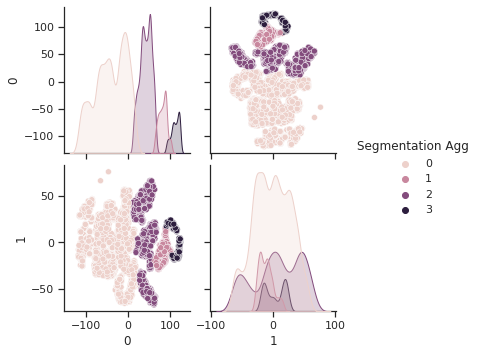

In [66]:
sb.pairplot(data=low_dim_tsne.loc[:, [0,1, 'Segmentation Agg']], hue='Segmentation Agg')

### Observation 
Clustering algorithms can't seperate data in good way, but the **Kmeans** and **Agglomerative** when the linkage is ***average*** is good enough. on orginal DataSet

### Apply PCA

In [67]:
pca = PCA(random_state=random_state)

In [68]:
train_transform = pd.DataFrame(pca.fit_transform(trainSet))
train_transform['Segmentation'] = trainCluster.values

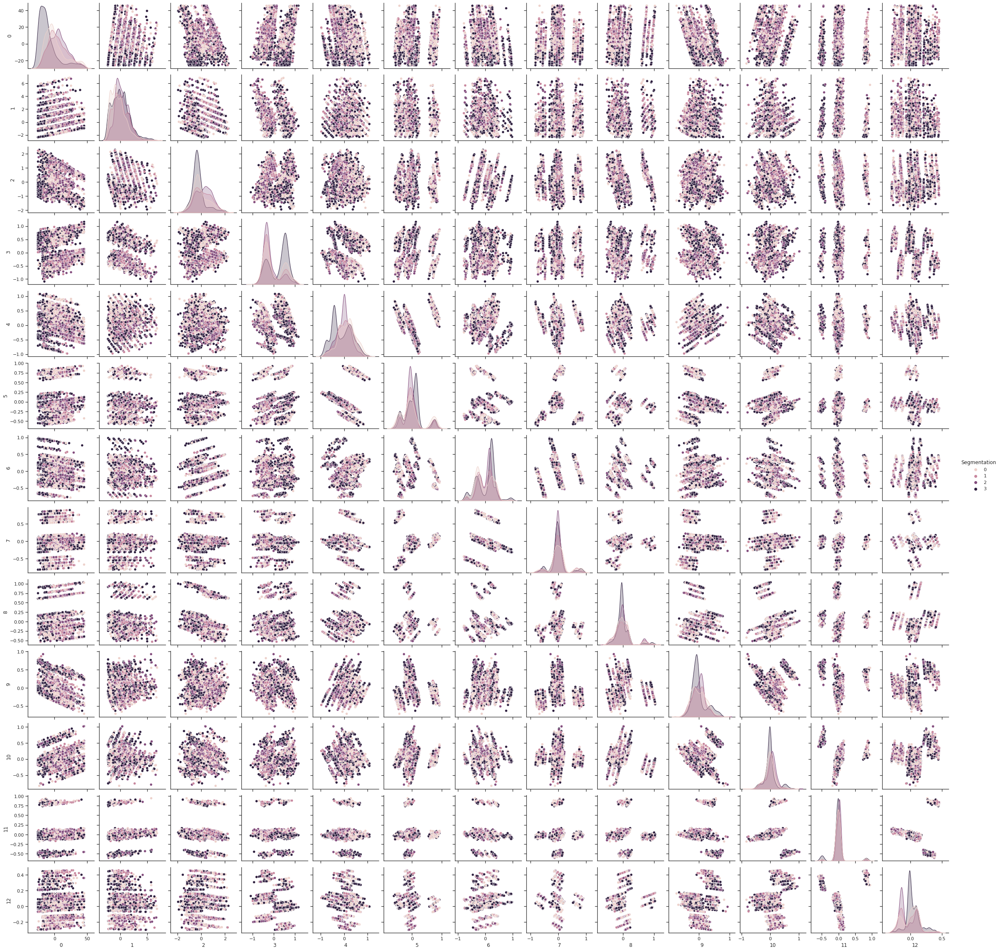

In [69]:
sb.pairplot(data=train_transform, hue='Segmentation')

In [70]:
pd.DataFrame(pca.components_)

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,0.018433,-0.023773,0.999296,0.016376,0.006846,-0.001904,-0.000534,-0.000194,0.002013,-0.010088,-0.000603,0.008773,-0.000862
1,0.141783,0.986359,0.020713,0.043550,-0.053636,-0.005432,0.003896,-0.004578,0.030841,0.025357,-0.010885,-0.003669,-0.000165
2,0.892236,-0.139727,-0.027913,0.378355,0.096945,-0.008709,-0.002751,-0.016164,0.118914,-0.124269,0.010762,-0.028946,-0.013423
3,0.148377,-0.076532,0.004210,-0.091979,-0.948193,-0.029111,0.059266,-0.075004,0.078950,0.189000,0.003683,0.110224,0.021833
4,-0.249651,0.019875,-0.005567,0.471974,-0.254489,0.121210,0.198659,0.414859,-0.023931,-0.633701,0.020126,-0.141033,0.031838
5,0.106766,-0.010291,0.001718,-0.150861,-0.007922,-0.335479,-0.365038,0.821141,-0.033999,0.205571,-0.029103,0.001529,-0.036534
6,-0.234764,-0.010629,-0.003336,0.722079,0.004997,-0.389835,0.036132,-0.111051,-0.090166,0.493972,-0.008727,-0.011229,-0.073418
7,0.090681,-0.000231,0.001057,-0.261732,0.071832,-0.595289,0.739827,0.049197,-0.036874,-0.093769,-0.000615,-0.060024,0.014915
8,-0.135007,-0.004779,0.002196,-0.021455,-0.007454,-0.299878,-0.226984,-0.138013,0.824175,-0.128568,0.039621,-0.341898,0.080473
9,-0.023385,0.019109,-0.008068,0.025441,-0.020987,-0.442137,-0.350502,-0.217757,-0.187504,-0.383137,0.199029,0.519586,0.375028


In [71]:
pca.explained_variance_

array([2.79673164e+02, 2.22909948e+00, 4.86188267e-01, 2.24450687e-01,
       1.41605758e-01, 1.05627747e-01, 9.71215693e-02, 8.40281270e-02,
       6.81496295e-02, 5.31040730e-02, 3.87520336e-02, 3.20366740e-02,
       1.96383771e-02])

In [72]:
pca.explained_variance_ratio_

array([9.87361818e-01, 7.86964215e-03, 1.71644546e-03, 7.92403659e-04,
       4.99926832e-04, 3.72909587e-04, 3.42879266e-04, 2.96654005e-04,
       2.40596349e-04, 1.87479318e-04, 1.36810689e-04, 1.13102695e-04,
       6.93315849e-05])

First **PC** contains ***98.76%*** of original info

In [73]:
test_transform = pd.DataFrame(pca.transform(testSet))
test_transform['Segmentation'] = testCluser.values

In [74]:
# Fit Kmeans on the all PCs
preds_train_red, preds_test_red = kmean(trainset=train_transform.iloc[:,:-1], testset=test_transform.iloc[:,:-1])

silhouette score Train = 0.5082490924997874
silhouette score Test =  0.5059655533435163


In [75]:
# Fit Kmeans only on the first PC
preds_train_red_pc1, preds_test_red_pc1 = kmean(trainset=np.array(train_transform.iloc[:,0]).reshape(-1,1),
                                                testset=np.array(test_transform.iloc[:,0]).reshape(-1,1))

silhouette score Train = 0.5634961829214162
silhouette score Test =  0.560570792754248


In [76]:
# Fit Agglomerative only on all PCs
preds_train_red_agg, preds_test_red_agg = agglomer(trainset=train_transform.iloc[:,:-1], testset=test_transform.iloc[:,:-1])

Linkage is :  ward
	silhouette score Train = 0.5016891689130382
	silhouette score Test =  0.5315430830744067
++++++++++++++++++++++++++++++++++++++++
Linkage is :  complete
	silhouette score Train = 0.49381049892624385
	silhouette score Test =  0.5308003500553541
++++++++++++++++++++++++++++++++++++++++
Linkage is :  average
	silhouette score Train = 0.5055527094404827
	silhouette score Test =  0.5308257615673408
++++++++++++++++++++++++++++++++++++++++
Linkage is :  single
	silhouette score Train = -0.3434842728242285
	silhouette score Test =  -0.3145254469184262
++++++++++++++++++++++++++++++++++++++++


In [77]:
# Fit Agglomerative only on the first PC
preds_train_red_agg_pc1, preds_test_red_agg_pc1 = agglomer(trainset=np.array(train_transform.iloc[:,0]).reshape(-1,1),
                                                           testset=np.array(test_transform.iloc[:,0]).reshape(-1,1))

Linkage is :  ward
	silhouette score Train = 0.5521147816387552
	silhouette score Test =  0.575518494919552
++++++++++++++++++++++++++++++++++++++++
Linkage is :  complete
	silhouette score Train = 0.5609694266783737
	silhouette score Test =  0.47035600997972565
++++++++++++++++++++++++++++++++++++++++
Linkage is :  average
	silhouette score Train = 0.5467161972019713
	silhouette score Test =  0.575518494919552
++++++++++++++++++++++++++++++++++++++++
Linkage is :  single
	silhouette score Train = 0.5111273749044992
	silhouette score Test =  0.5348921360382974
++++++++++++++++++++++++++++++++++++++++


In [78]:
train_transform['Segmentation K'] = preds_train_red
test_transform['Segmentation K'] = preds_test_red

train_transform['Segmentation K-PC1'] = preds_train_red_pc1
test_transform['Segmentation K-PC1'] = preds_test_red_pc1

#____________________________________________________________________________#

preds_train_red_agg, preds_test_red_agg = preds_train_red_agg[0], \
                                           preds_test_red_agg[0]
preds_train_red_agg_pc1, preds_test_red_agg_pc1 = preds_train_red_agg_pc1[0],\
                                                   preds_test_red_agg_pc1[0]

train_transform['Segmentation agg'] = preds_train_red_agg
test_transform['Segmentation agg'] = preds_test_red_agg

train_transform['Segmentation agg-PC1'] = preds_train_red_agg_pc1
test_transform['Segmentation agg-PC1'] = preds_test_red_agg_pc1


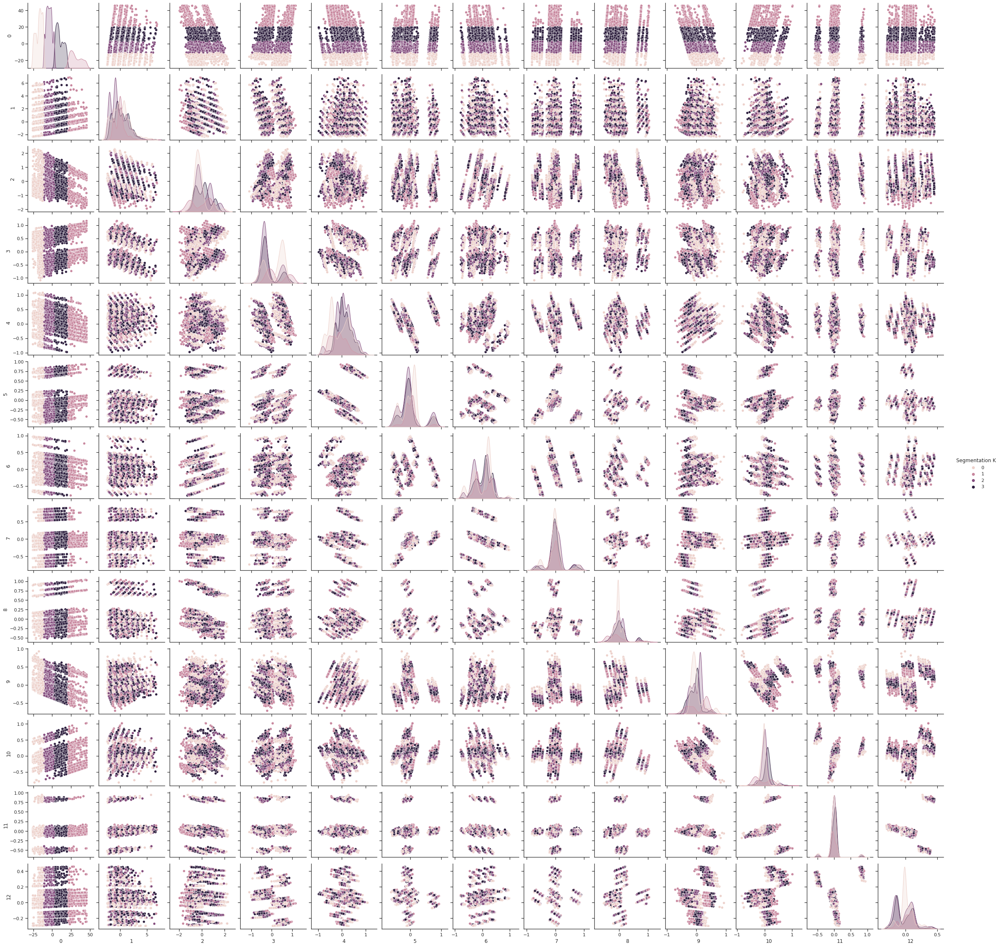

In [79]:
sb.pairplot(data=train_transform.loc[:,[ 0,1,2,3,4,5,6,7,8,9,10,11,12, 'Segmentation K']], hue='Segmentation K')

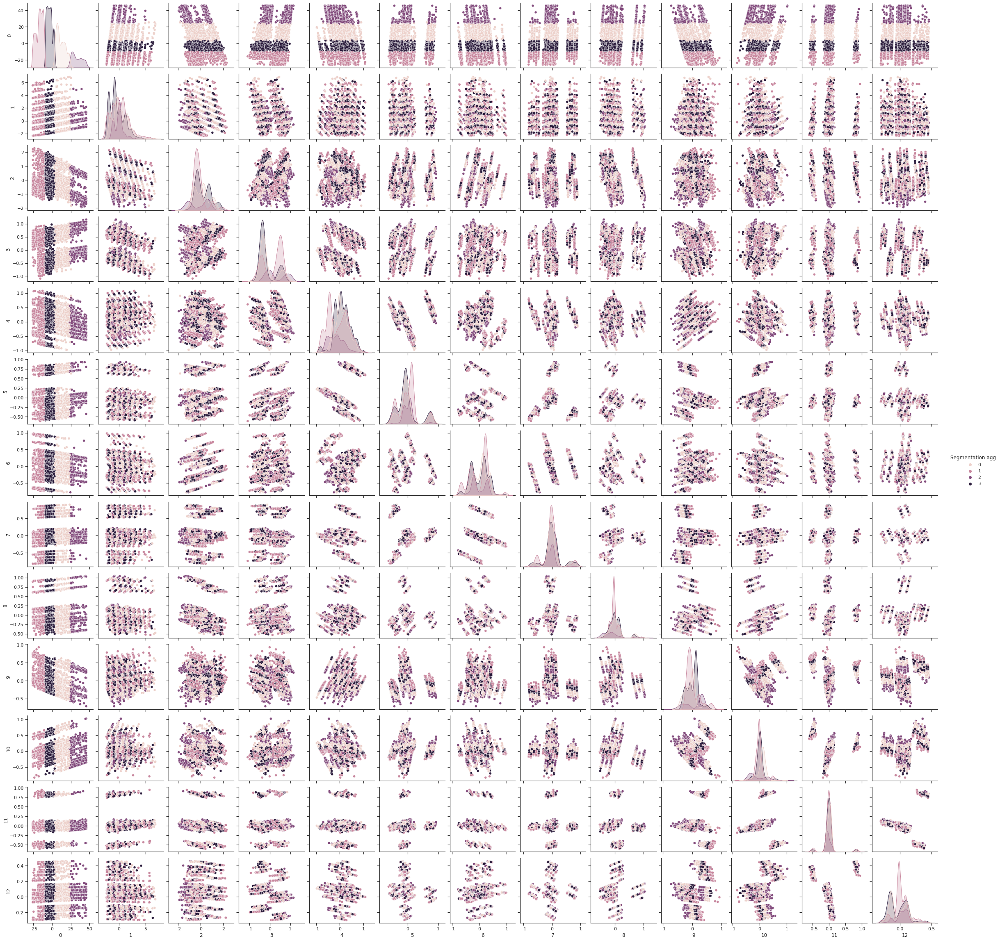

In [80]:
sb.pairplot(data=train_transform.loc[:, [0,1,2,3,4,5,6,7,8,9,10,11,12, 'Segmentation agg']], hue='Segmentation agg')

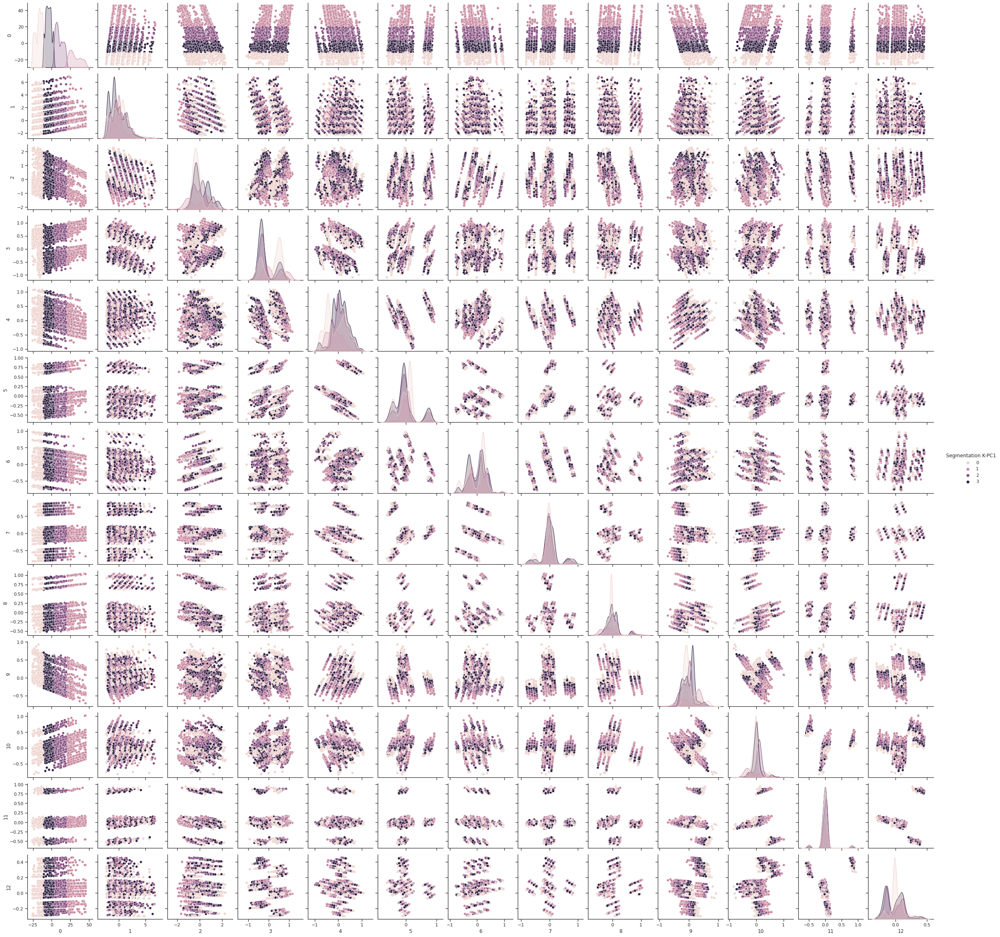

In [81]:
sb.pairplot(data=train_transform.loc[:, [0,1,2,3,4,5,6,7,8,9,10,11,12, 'Segmentation K-PC1']], hue='Segmentation K-PC1')

Based on ***silhouette score***
The **Kmeans** splits the data in the same way of orginal data.
the **agglomerative clustering** splits the data in the same way of orginal data, but in ***ward*** linkage


In [82]:
gaussian(trainset=train_transform.iloc[:,:-1], testset=test_transform.iloc[:,:-1])

/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,


silhouette score Train = 0.5176600167918224
silhouette score Test =  0.36410169525733005


(array([1, 2, 3, ..., 2, 1, 2]), array([2, 2, 3, ..., 0, 0, 2]))

In [83]:
dbscan(trainset=train_transform.iloc[:,:-1], testset=test_transform.iloc[:,:-1])

/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,


silhouette score Train = -0.5359778218313621
silhouette score Test =  -0.5823653146778565


(array([  0,  -1,  -1, ..., 145,  -1,  -1]),
 array([-1, -1, -1, ..., -1, -1, -1]))

#### Apply TSNA

In [84]:
tsne = TSNE(random_state=random_state, init='pca')

In [ ]:
low_dim_pca_tsne_train = pd.DataFrame(tsne.fit_transform(train_transform))
low_dim_pca_tsne_train['Segmentation origin'] = trainCluster.values
low_dim_pca_tsne_train['Segmentation Kmeans'] = preds_train_red
low_dim_pca_tsne_train['Segmentation Agg'] = preds_train_red_agg

low_dim_pca_tsne_test = pd.DataFrame(tsne.fit_transform(test_transform))
low_dim_pca_tsne_test['Segmentation origin'] = testCluser
low_dim_pca_tsne_test['Segmentation Kmeans'] = preds_test_red
low_dim_pca_tsne_test['Segmentation Agg'] = preds_test_red_agg

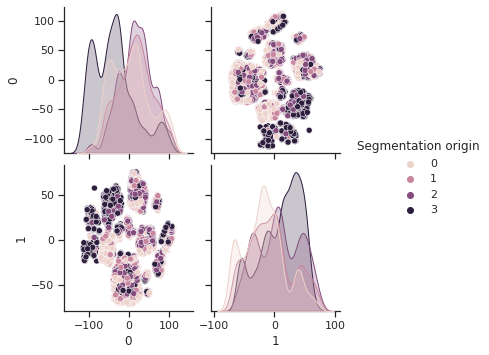

In [86]:
sb.pairplot(data=low_dim_pca_tsne_train.loc[:,[0,1, 'Segmentation origin']], hue='Segmentation origin')

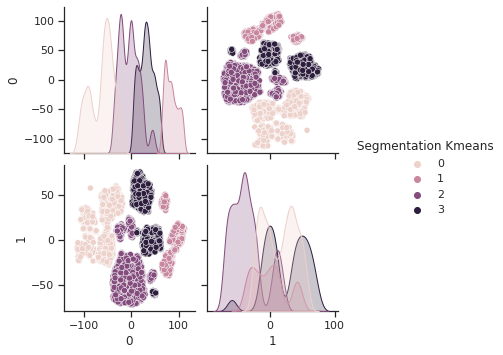

In [87]:
sb.pairplot(data=low_dim_pca_tsne_train.loc[:,[0,1, 'Segmentation Kmeans']], hue='Segmentation Kmeans')

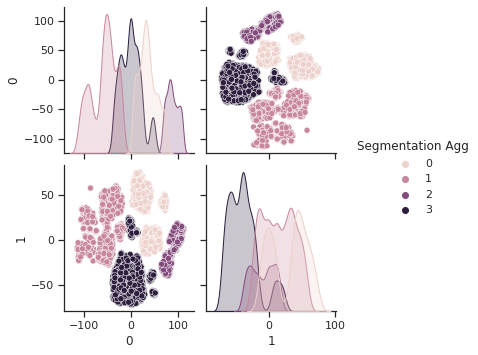

In [88]:
sb.pairplot(data=low_dim_pca_tsne_train.loc[:,[0,1, 'Segmentation Agg']], hue='Segmentation Agg')

### Observation 
Clustering algorithms work on both the original data and the data that comes from **PCA** in almost the same way. i.e, these algorithms group the data in the almost same way. 

The performance Clustering algorithms on the **First PC** is the same or higher in clustering. this means that **PCA** was able to extract the variations only in 1 **PC**.

This proves  that **PCA** retains the original information without losing, but in the form of ***variants*** between the data.



## Classification Models 

In [89]:
def knn_fit(trainset=trainSet, trainClasess=trainCluster, testset=testSet, testClasses=testCluser):
    """
    To Chooce the best of k in  K-Nearest Neighbor
    :param trainset: Train DataSet
    :param trainClasess: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClasses: The actual segmentations in testing set
    :return: None
    """
    train_error, test_error = [], []

    for k in range(3, 12, 2):
      model = KNeighborsClassifier(n_neighbors=k)
      model.fit(trainset, trainClasess)
      train_error.append(np.mean(model.predict(trainset) != trainClasess.values))
      test_error.append(np.mean(model.predict(testset) != testClasses.values))
      pass

    py.plot(range(3, 12, 2), train_error, label='Train Error') 
    py.plot(range(3, 12, 2), test_error, label='Test Error')
    py.xlabel('K values')
    py.ylabel('Error')
    py.legend()
    py.show()
    pass

def knn_apply(k, trainset=trainSet, trainClasess=trainCluster, testset=testSet, testClasses=testCluser):
    """
    Run K-Nearest Neighbor on the dataset
    :param k: Number of Nearest Neighbor for point
    :param trainset: Train DataSet
    :param trainClasess: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClasses: The actual segmentations in testing set
    :return: model object
    """

    model = KNeighborsClassifier(n_neighbors=k)
    model.fit(trainset, trainClasess)

    preds_train = model.predict(trainset)
    print("In Train Set")
    print('\t\t Accuracy Score = ', accuracy_score(trainClasess, preds_train))
    ConfusionMatrixDisplay(confusion_matrix(trainClasess, preds_train)).plot()
    py.title("Display Confusion Matrix for Train Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(trainClasess, preds_train))

    preds_test = model.predict(testset)
    print("In Test Set")
    print('\t\t Accuracy Score = ', accuracy_score(testClasses, preds_test))
    ConfusionMatrixDisplay(confusion_matrix(testClasses, preds_test)).plot()
    py.title("Display Confusion Matrix for Test Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(testClasses, preds_test))
  
    return model

In [90]:
def random_forest(trainset=trainSet, trainClasess=trainCluster, testset=testSet, testClasses=testCluser):
    """
    Run Random Forest on the dataset
    :param trainset: Train DataSet
    :param trainClasess: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClasses: The actual segmentations in testing set
    :return: model object
    """
    model = RandomForestClassifier(random_state=random_state, n_estimators=300)
    model.fit(trainset, trainClasess)
    
    preds_train = model.predict(trainset)
    print("In Train Set")
    print('\t\t Accuracy Score = ', accuracy_score(trainClasess, preds_train))
    ConfusionMatrixDisplay(confusion_matrix(trainClasess, preds_train)).plot()
    py.title("Display Confusion Matrix for Train Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(trainClasess, preds_train))

    preds_test = model.predict(testset)
    print("In Test Set")
    print('\t\t Accuracy Score = ', accuracy_score(testClasses, preds_test))
    ConfusionMatrixDisplay(confusion_matrix(testClasses, preds_test)).plot()
    py.title("Display Confusion Matrix for Test Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(testClasses, preds_test))
    
    return model

In [91]:
def svm(trainset=trainSet, trainClasess=trainCluster, testset=testSet, testClasses=testCluser):
    """
    Run Support Vector Machine on the dataset
    :param trainset: Train DataSet
    :param trainClasess: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClasses: The actual segmentations in testing set
    :return: model object
    """
    model = SVC(C=0.8, probability=True, kernel='linear', random_state=random_state, max_iter=max_itr)
    model.fit(trainset, trainClasess)
    
    preds_train = model.predict(trainset)
    print("In Train Set")
    print('\t\t Accuracy Score = ', accuracy_score(trainClasess, preds_train))
    ConfusionMatrixDisplay(confusion_matrix(trainClasess, preds_train)).plot()
    py.title("Display Confusion Matrix for Train Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(trainClasess, preds_train))

    preds_test = model.predict(testset)
    print("In Test Set")
    print('\t\t Accuracy Score = ', accuracy_score(testClasses, preds_test))
    ConfusionMatrixDisplay(confusion_matrix(testClasses, preds_test)).plot()
    py.title("Display Confusion Matrix for Test Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(testClasses, preds_test))
    
    return model

In [92]:
def adaboost(trainset=trainSet, trainClasess=trainCluster, testset=testSet, testClasses=testCluser):
    """
    Run Ada Boost on the dataset
    :param trainset: Train DataSet
    :param trainClasess: The actual segmentations in training set
    :param testset: Test DataSet
    :param testClasses: The actual segmentations in testing set
    :return: model object
    """
    model = AdaBoostClassifier(random_state=random_state, n_estimators=300)
    model.fit(trainset, trainClasess)
    
    preds_train = model.predict(trainset)
    print("In Train Set")
    print('\t\t Accuracy Score = ', accuracy_score(trainClasess, preds_train))
    ConfusionMatrixDisplay(confusion_matrix(trainClasess, preds_train)).plot()
    py.title("Display Confusion Matrix for Train Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(trainClasess, preds_train))

    preds_test = model.predict(testset)
    print("In Test Set")
    print('\t\t Accuracy Score = ', accuracy_score(testClasses, preds_test))
    ConfusionMatrixDisplay(confusion_matrix(testClasses, preds_test)).plot()
    py.title("Display Confusion Matrix for Test Set")
    py.show()
    print('\t\t Classification Report = ', classification_report(testClasses, preds_test))
    
    return model

#### Original Dataset

##### KNN 

with actual lables

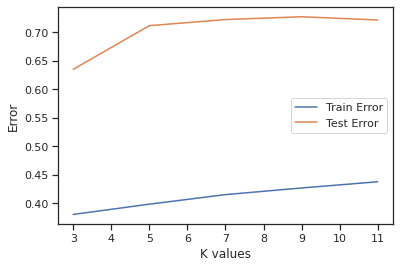

In [93]:
knn_fit()

In Train Set
		 Accuracy Score =  0.6015121467526029


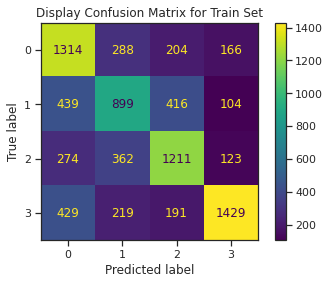

		 Classification Report =                precision    recall  f1-score   support

           0       0.54      0.67      0.59      1972
           1       0.51      0.48      0.50      1858
           2       0.60      0.61      0.61      1970
           3       0.78      0.63      0.70      2268

    accuracy                           0.60      8068
   macro avg       0.61      0.60      0.60      8068
weighted avg       0.61      0.60      0.60      8068

In Test Set
		 Accuracy Score =  0.2885420631899505


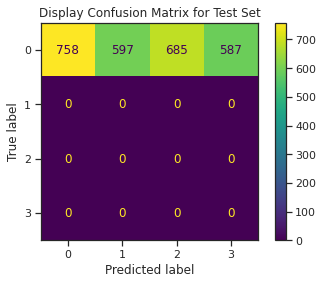

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.29      0.45      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.29      2627
   macro avg       0.25      0.07      0.11      2627
weighted avg       1.00      0.29      0.45      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [94]:
knn_model = knn_apply(k=5)

 with Kmeans lables

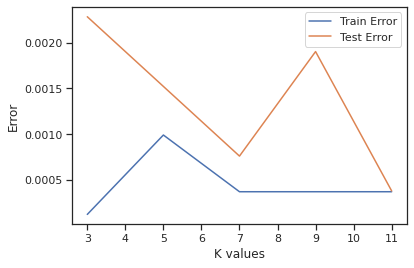

In [95]:
knn_fit(trainClasess=pd.Series(preds_train_or), testClasses=pd.Series(preds_test_or))

In Train Set
		 Accuracy Score =  0.9996281606346058


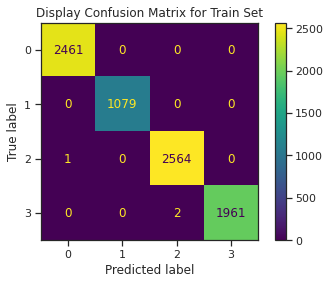

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      2565
           3       1.00      1.00      1.00      1963

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.9996193376475067


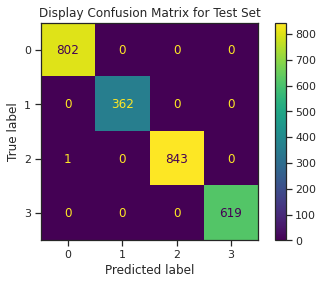

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       844
           3       1.00      1.00      1.00       619

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



In [96]:
knn_model = knn_apply(k=11, trainClasess=pd.Series(preds_train_or), testClasses=pd.Series(preds_test_or))

 with Agglomerative lables

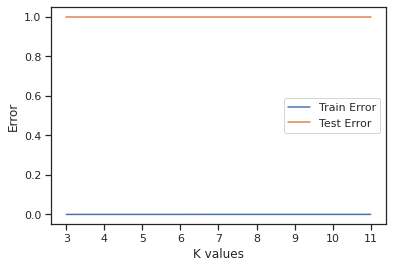

In [97]:
knn_fit(trainClasess=pd.Series(preds_train_agg), testClasses=pd.Series(preds_test_agg))

There are overfitting

##### Random Forest

In Train Set
		 Accuracy Score =  0.7607833415964304


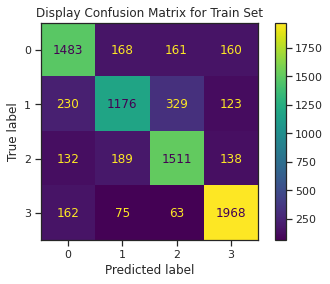

		 Classification Report =                precision    recall  f1-score   support

           0       0.74      0.75      0.75      1972
           1       0.73      0.63      0.68      1858
           2       0.73      0.77      0.75      1970
           3       0.82      0.87      0.85      2268

    accuracy                           0.76      8068
   macro avg       0.76      0.75      0.75      8068
weighted avg       0.76      0.76      0.76      8068

In Test Set
		 Accuracy Score =  0.2539017891130567


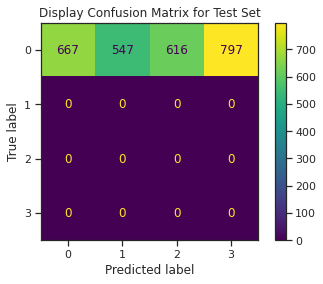

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.25      0.40      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.25      2627
   macro avg       0.25      0.06      0.10      2627
weighted avg       1.00      0.25      0.40      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


RandomForestClassifier(n_estimators=300, random_state=45)

In [99]:
# with actual lables
random_forest()

In Train Set
		 Accuracy Score =  1.0


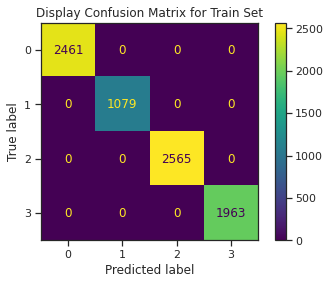

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      2565
           3       1.00      1.00      1.00      1963

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.9996193376475067


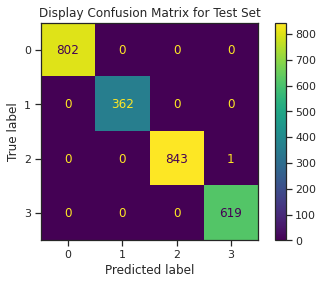

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       844
           3       1.00      1.00      1.00       619

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



RandomForestClassifier(n_estimators=300, random_state=45)

In [100]:
# with Kmeans lables
random_forest(trainClasess=pd.Series(preds_train_or), testClasses=pd.Series(preds_test_or))

In Train Set
		 Accuracy Score =  1.0


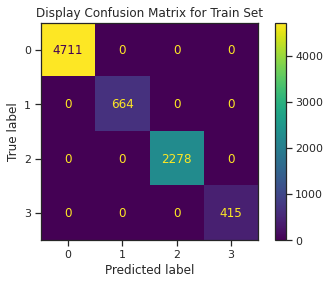

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      4711
           1       1.00      1.00      1.00       664
           2       1.00      1.00      1.00      2278
           3       1.00      1.00      1.00       415

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.0


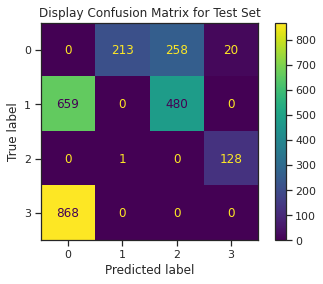

		 Classification Report =                precision    recall  f1-score   support

           0       0.00      0.00      0.00     491.0
           1       0.00      0.00      0.00    1139.0
           2       0.00      0.00      0.00     129.0
           3       0.00      0.00      0.00     868.0

    accuracy                           0.00    2627.0
   macro avg       0.00      0.00      0.00    2627.0
weighted avg       0.00      0.00      0.00    2627.0



RandomForestClassifier(n_estimators=300, random_state=45)

In [101]:
# with agglomerative labels
random_forest(trainClasess=pd.Series(preds_train_agg), testClasses=pd.Series(preds_test_agg))

##### SVM

/opt/conda/lib/python3.7/site-packages/sklearn/svm/_base.py:289: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  ConvergenceWarning,


In Train Set
		 Accuracy Score =  0.38063956370847796


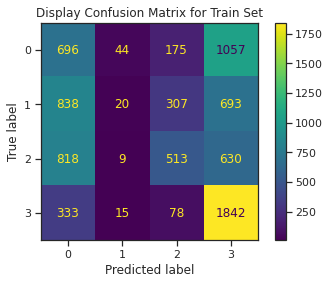

		 Classification Report =                precision    recall  f1-score   support

           0       0.26      0.35      0.30      1972
           1       0.23      0.01      0.02      1858
           2       0.48      0.26      0.34      1970
           3       0.44      0.81      0.57      2268

    accuracy                           0.38      8068
   macro avg       0.35      0.36      0.31      8068
weighted avg       0.36      0.38      0.32      8068

In Test Set
		 Accuracy Score =  0.3395508184240579


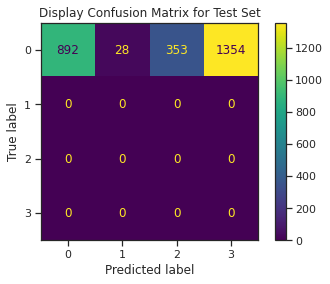

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.34      0.51      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.34      2627
   macro avg       0.25      0.08      0.13      2627
weighted avg       1.00      0.34      0.51      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [102]:
# with actual labels
svm()

In Train Set
		 Accuracy Score =  1.0


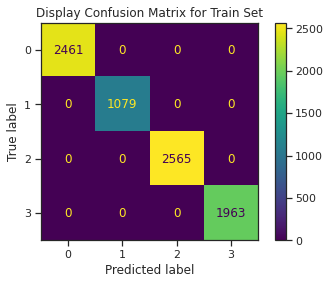

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      2565
           3       1.00      1.00      1.00      1963

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  1.0


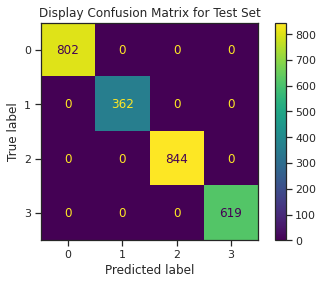

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       844
           3       1.00      1.00      1.00       619

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [103]:
# with Kmeans lables
svm(trainClasess=pd.Series(preds_train_or), testClasses=pd.Series(preds_test_or))

In Train Set
		 Accuracy Score =  0.9997521070897373


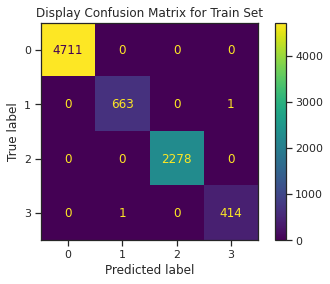

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      4711
           1       1.00      1.00      1.00       664
           2       1.00      1.00      1.00      2278
           3       1.00      1.00      1.00       415

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.0


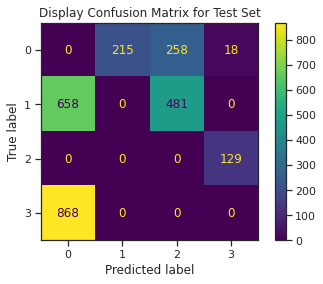

		 Classification Report =                precision    recall  f1-score   support

           0       0.00      0.00      0.00     491.0
           1       0.00      0.00      0.00    1139.0
           2       0.00      0.00      0.00     129.0
           3       0.00      0.00      0.00     868.0

    accuracy                           0.00    2627.0
   macro avg       0.00      0.00      0.00    2627.0
weighted avg       0.00      0.00      0.00    2627.0



SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [104]:
# with agglomerative lables
svm(trainClasess=pd.Series(preds_train_agg), testClasses=pd.Series(preds_test_agg))

##### AdaBoost

In Train Set
		 Accuracy Score =  0.5183440753594447


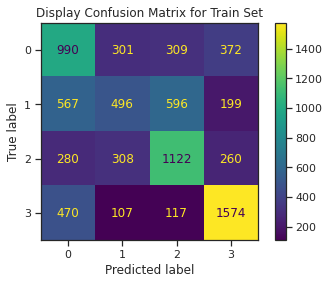

		 Classification Report =                precision    recall  f1-score   support

           0       0.43      0.50      0.46      1972
           1       0.41      0.27      0.32      1858
           2       0.52      0.57      0.55      1970
           3       0.65      0.69      0.67      2268

    accuracy                           0.52      8068
   macro avg       0.50      0.51      0.50      8068
weighted avg       0.51      0.52      0.51      8068

In Test Set
		 Accuracy Score =  0.2972972972972973


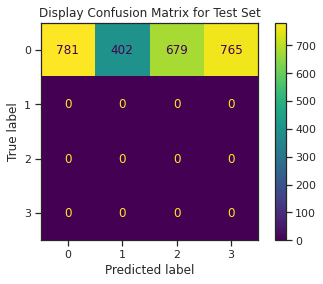

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.30      0.46      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.30      2627
   macro avg       0.25      0.07      0.11      2627
weighted avg       1.00      0.30      0.46      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [105]:
# with actual lables
adaboost()

In Train Set
		 Accuracy Score =  0.7566931085770947


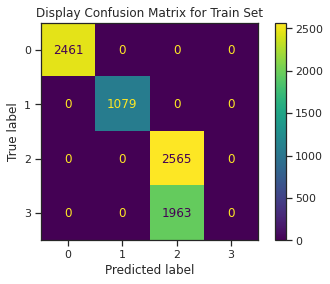

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       0.57      1.00      0.72      2565
           3       0.00      0.00      0.00      1963

    accuracy                           0.76      8068
   macro avg       0.64      0.75      0.68      8068
weighted avg       0.62      0.76      0.67      8068

In Test Set
		 Accuracy Score =  0.7643700038066236


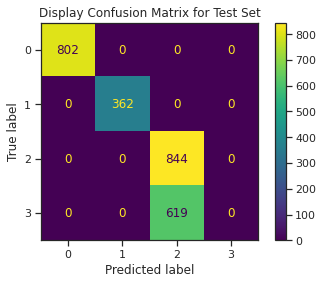

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       0.58      1.00      0.73       844
           3       0.00      0.00      0.00       619

    accuracy                           0.76      2627
   macro avg       0.64      0.75      0.68      2627
weighted avg       0.63      0.76      0.68      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [106]:
# with Kmeans lables
adaboost(trainClasess=pd.Series(preds_train_or), testClasses=pd.Series(preds_test_or))

In Train Set
		 Accuracy Score =  0.9481903817550819


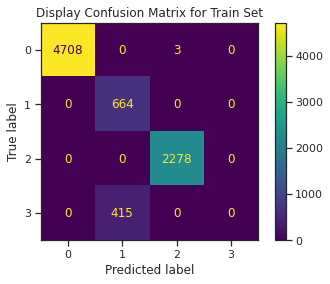

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      4711
           1       0.62      1.00      0.76       664
           2       1.00      1.00      1.00      2278
           3       0.00      0.00      0.00       415

    accuracy                           0.95      8068
   macro avg       0.65      0.75      0.69      8068
weighted avg       0.92      0.95      0.93      8068

In Test Set
		 Accuracy Score =  0.0


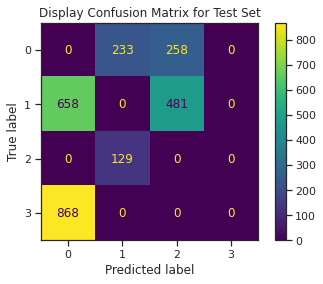

		 Classification Report =                precision    recall  f1-score   support

           0       0.00      0.00      0.00     491.0
           1       0.00      0.00      0.00    1139.0
           2       0.00      0.00      0.00     129.0
           3       0.00      0.00      0.00     868.0

    accuracy                           0.00    2627.0
   macro avg       0.00      0.00      0.00    2627.0
weighted avg       0.00      0.00      0.00    2627.0



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [107]:
# with agglomerative lables
adaboost(trainClasess=pd.Series(preds_train_agg), testClasses=pd.Series(preds_test_agg))

#### Observation
Original Data is not distributed properly to the actual segments. i.e there are no patterns. 

**`But the Kmeans groups the data well`**.
and agglomerative can't groups data well.

This is shown in the classification algorithms' handling of them.

#### PCA data

##### KNN 

with actual lables

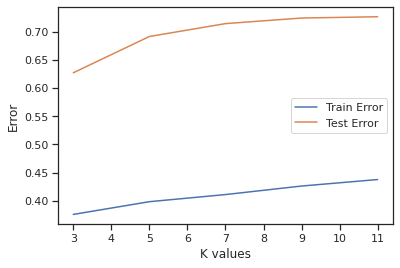

In [108]:
knn_fit(trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12])

In Train Set
		 Accuracy Score =  0.624194348041646


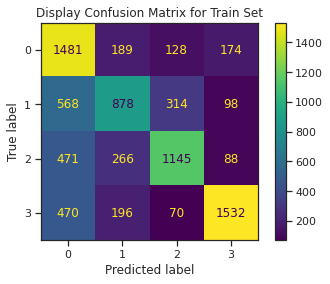

		 Classification Report =                precision    recall  f1-score   support

           0       0.50      0.75      0.60      1972
           1       0.57      0.47      0.52      1858
           2       0.69      0.58      0.63      1970
           3       0.81      0.68      0.74      2268

    accuracy                           0.62      8068
   macro avg       0.64      0.62      0.62      8068
weighted avg       0.65      0.62      0.63      8068

In Test Set
		 Accuracy Score =  0.37304910544347164


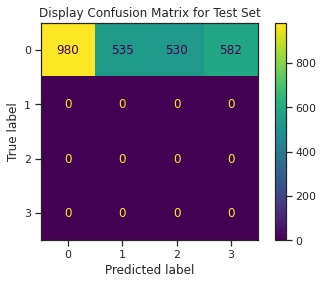

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.37      0.54      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.37      2627
   macro avg       0.25      0.09      0.14      2627
weighted avg       1.00      0.37      0.54      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [109]:
knn_model_all = knn_apply(k=3, trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12])

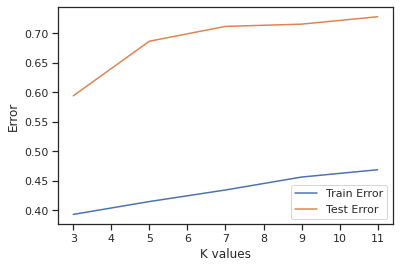

In [110]:
knn_fit(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1))

In Train Set
		 Accuracy Score =  0.6072136836886465


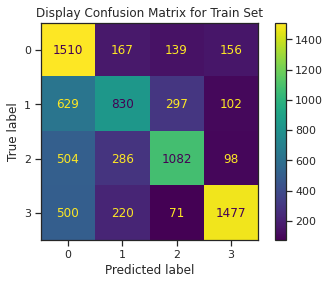

		 Classification Report =                precision    recall  f1-score   support

           0       0.48      0.77      0.59      1972
           1       0.55      0.45      0.49      1858
           2       0.68      0.55      0.61      1970
           3       0.81      0.65      0.72      2268

    accuracy                           0.61      8068
   macro avg       0.63      0.60      0.60      8068
weighted avg       0.64      0.61      0.61      8068

In Test Set
		 Accuracy Score =  0.40616673011039206


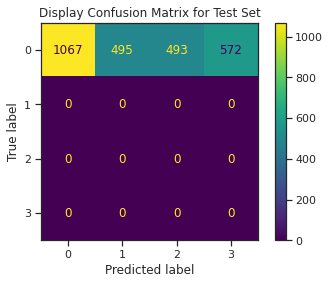

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.41      0.58      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.41      2627
   macro avg       0.25      0.10      0.14      2627
weighted avg       1.00      0.41      0.58      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


KNeighborsClassifier(n_neighbors=3)

In [111]:
knn_apply(k=3,trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1))

 with Kmeans lables

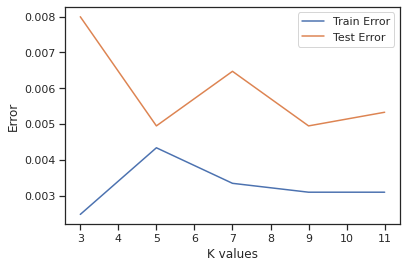

In [112]:
knn_fit(trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12], 
        trainClasess=train_transform['Segmentation K'], testClasses=test_transform['Segmentation K'])

In Train Set
		 Accuracy Score =  0.9969013386217154


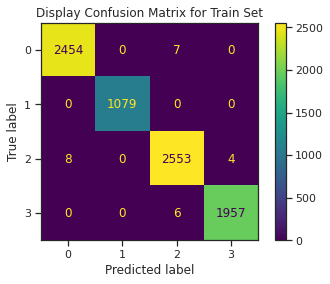

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       0.99      1.00      1.00      2565
           3       1.00      1.00      1.00      1963

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.9946707270650933


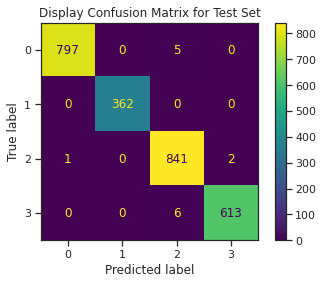

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.99      1.00       802
           1       1.00      1.00      1.00       362
           2       0.99      1.00      0.99       844
           3       1.00      0.99      0.99       619

    accuracy                           0.99      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       0.99      0.99      0.99      2627



In [113]:
knn_model = knn_apply(k=11,trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12],
                      trainClasess=train_transform['Segmentation K'], testClasses=test_transform['Segmentation K'])

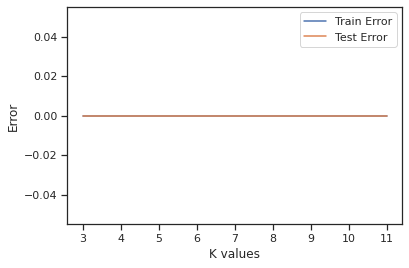

In [114]:
knn_fit(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
        trainClasess=train_transform['Segmentation K-PC1'], testClasses=test_transform['Segmentation K-PC1'])

In Train Set
		 Accuracy Score =  1.0


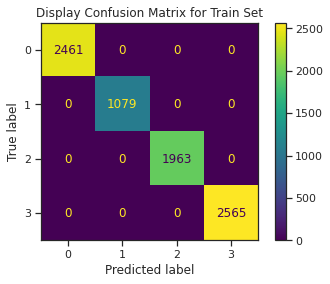

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      1963
           3       1.00      1.00      1.00      2565

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  1.0


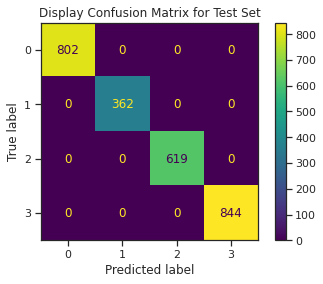

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       619
           3       1.00      1.00      1.00       844

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



In [115]:
knn_model = knn_apply(k=3,trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1),
                      testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1), trainClasess=train_transform['Segmentation K-PC1'],
                      testClasses=test_transform['Segmentation K-PC1'])

with Agglomerative lables

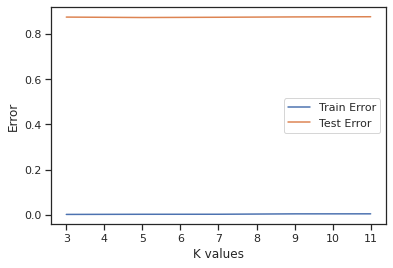

In [116]:
knn_fit(trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12],
                    trainClasess=train_transform['Segmentation agg'], testClasses=test_transform['Segmentation agg'])

There are overfitting

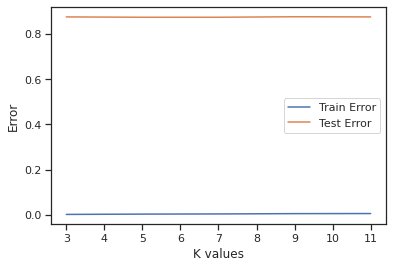

In [118]:
knn_fit(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
                    trainClasess=train_transform['Segmentation agg'], testClasses=test_transform['Segmentation agg'])

There are overfitting

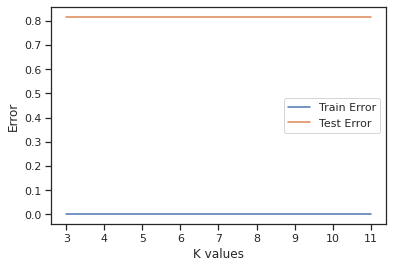

In [120]:
knn_fit(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
                    trainClasess=train_transform['Segmentation agg-PC1'], testClasses=test_transform['Segmentation agg-PC1'])

There are overfitting

##### Random Forest

In Train Set
		 Accuracy Score =  0.760659395141299


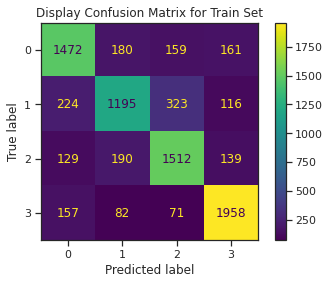

		 Classification Report =                precision    recall  f1-score   support

           0       0.74      0.75      0.74      1972
           1       0.73      0.64      0.68      1858
           2       0.73      0.77      0.75      1970
           3       0.82      0.86      0.84      2268

    accuracy                           0.76      8068
   macro avg       0.76      0.76      0.75      8068
weighted avg       0.76      0.76      0.76      8068

In Test Set
		 Accuracy Score =  0.2535211267605634


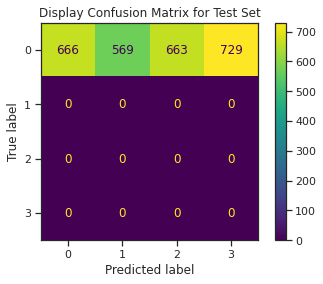

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.25      0.40      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.25      2627
   macro avg       0.25      0.06      0.10      2627
weighted avg       1.00      0.25      0.40      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


RandomForestClassifier(n_estimators=300, random_state=45)

In [122]:
# with actual lables
random_forest(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1)) 

In Train Set
		 Accuracy Score =  1.0


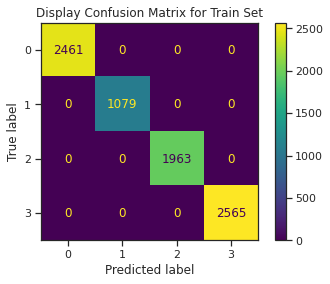

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      1963
           3       1.00      1.00      1.00      2565

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  1.0


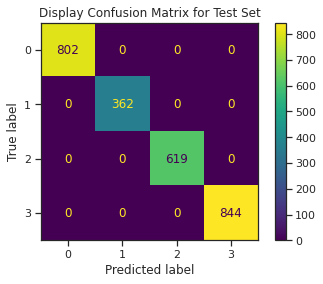

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       619
           3       1.00      1.00      1.00       844

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



RandomForestClassifier(n_estimators=300, random_state=45)

In [123]:
# with Kmeans lables
random_forest(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
              trainClasess=train_transform['Segmentation K-PC1'], testClasses=test_transform['Segmentation K-PC1'])

In Train Set
		 Accuracy Score =  1.0


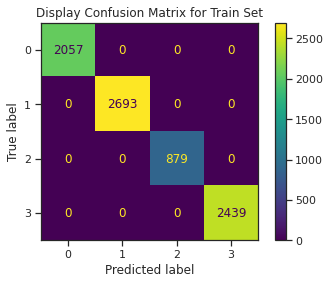

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2057
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00       879
           3       1.00      1.00      1.00      2439

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.12523791397030834


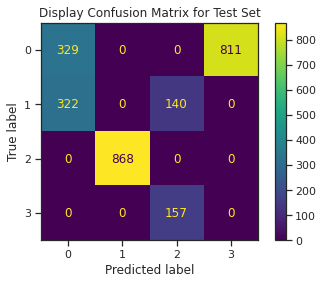

		 Classification Report =                precision    recall  f1-score   support

           0       0.51      0.29      0.37      1140
           1       0.00      0.00      0.00       462
           2       0.00      0.00      0.00       868
           3       0.00      0.00      0.00       157

    accuracy                           0.13      2627
   macro avg       0.13      0.07      0.09      2627
weighted avg       0.22      0.13      0.16      2627



RandomForestClassifier(n_estimators=300, random_state=45)

In [124]:
# with Agglomerative lables of all PCS
random_forest(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
              trainClasess=train_transform['Segmentation agg'], testClasses=test_transform['Segmentation agg'])

In Train Set
		 Accuracy Score =  1.0


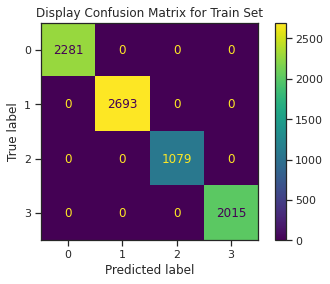

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2281
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00      1079
           3       1.00      1.00      1.00      2015

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.18309859154929578


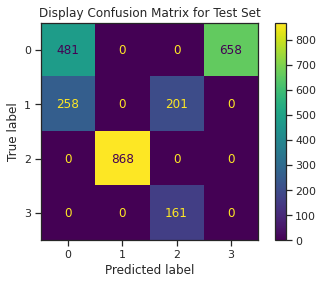

		 Classification Report =                precision    recall  f1-score   support

           0       0.65      0.42      0.51      1139
           1       0.00      0.00      0.00       459
           2       0.00      0.00      0.00       868
           3       0.00      0.00      0.00       161

    accuracy                           0.18      2627
   macro avg       0.16      0.11      0.13      2627
weighted avg       0.28      0.18      0.22      2627



RandomForestClassifier(n_estimators=300, random_state=45)

In [125]:
# with Agglomerative lables of PC1
random_forest(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
              trainClasess=train_transform['Segmentation agg-PC1'], testClasses=test_transform['Segmentation agg-PC1'])

##### SVM

/opt/conda/lib/python3.7/site-packages/sklearn/svm/_base.py:289: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  ConvergenceWarning,


In Train Set
		 Accuracy Score =  0.3247397124442241


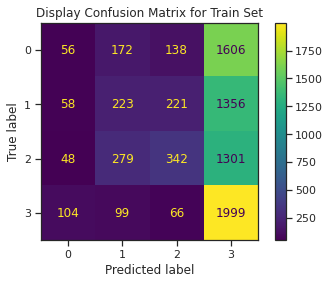

		 Classification Report =                precision    recall  f1-score   support

           0       0.21      0.03      0.05      1972
           1       0.29      0.12      0.17      1858
           2       0.45      0.17      0.25      1970
           3       0.32      0.88      0.47      2268

    accuracy                           0.32      8068
   macro avg       0.32      0.30      0.23      8068
weighted avg       0.32      0.32      0.24      8068

In Test Set
		 Accuracy Score =  0.03235629996193377


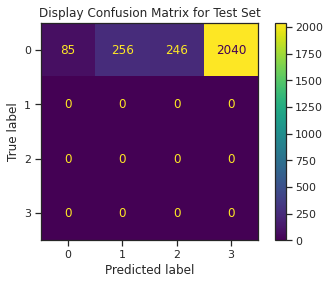

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.03      0.06      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.03      2627
   macro avg       0.25      0.01      0.02      2627
weighted avg       1.00      0.03      0.06      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [126]:
# with actual lables
svm(trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12])
# don't work well with first component

In Train Set
		 Accuracy Score =  1.0


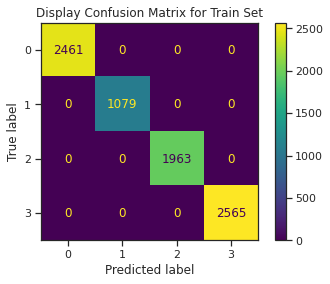

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       1.00      1.00      1.00      1963
           3       1.00      1.00      1.00      2565

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  1.0


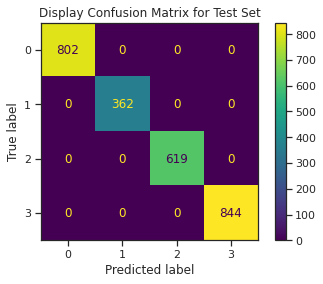

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       1.00      1.00      1.00       619
           3       1.00      1.00      1.00       844

    accuracy                           1.00      2627
   macro avg       1.00      1.00      1.00      2627
weighted avg       1.00      1.00      1.00      2627



SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [127]:
# with Kmeans lables
svm(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1), 
    trainClasess=train_transform['Segmentation K-PC1'], testClasses=test_transform['Segmentation K-PC1'])

In Train Set
		 Accuracy Score =  1.0


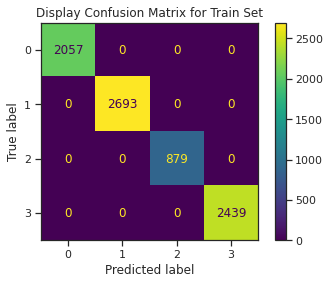

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2057
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00       879
           3       1.00      1.00      1.00      2439

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.12523791397030834


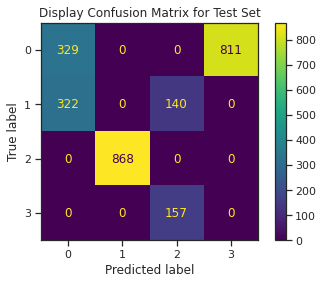

		 Classification Report =                precision    recall  f1-score   support

           0       0.51      0.29      0.37      1140
           1       0.00      0.00      0.00       462
           2       0.00      0.00      0.00       868
           3       0.00      0.00      0.00       157

    accuracy                           0.13      2627
   macro avg       0.13      0.07      0.09      2627
weighted avg       0.22      0.13      0.16      2627



RandomForestClassifier(n_estimators=300, random_state=45)

In [128]:
# with Agglomerative lables
random_forest(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
              trainClasess=train_transform['Segmentation agg'], testClasses=test_transform['Segmentation agg'])

In Train Set
		 Accuracy Score =  1.0


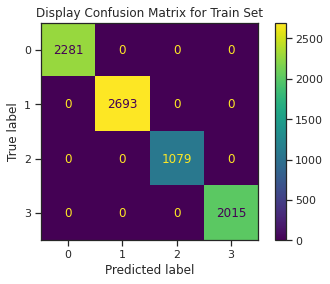

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2281
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00      1079
           3       1.00      1.00      1.00      2015

    accuracy                           1.00      8068
   macro avg       1.00      1.00      1.00      8068
weighted avg       1.00      1.00      1.00      8068

In Test Set
		 Accuracy Score =  0.18309859154929578


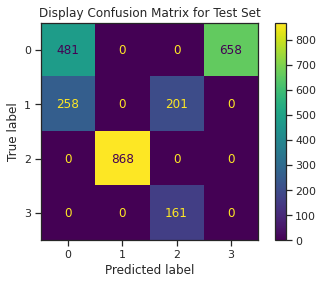

		 Classification Report =                precision    recall  f1-score   support

           0       0.65      0.42      0.51      1139
           1       0.00      0.00      0.00       459
           2       0.00      0.00      0.00       868
           3       0.00      0.00      0.00       161

    accuracy                           0.18      2627
   macro avg       0.16      0.11      0.13      2627
weighted avg       0.28      0.18      0.22      2627



SVC(C=0.8, kernel='linear', max_iter=500, probability=True, random_state=45)

In [129]:
# with Agglomerative lables
svm(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
              trainClasess=train_transform['Segmentation agg-PC1'], testClasses=test_transform['Segmentation agg-PC1'])

##### AdaBoost

In Train Set
		 Accuracy Score =  0.5467278135845315


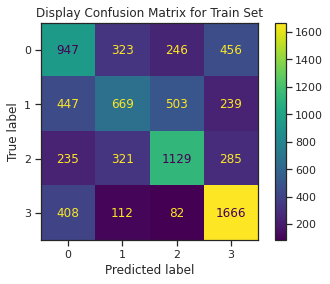

		 Classification Report =                precision    recall  f1-score   support

           0       0.46      0.48      0.47      1972
           1       0.47      0.36      0.41      1858
           2       0.58      0.57      0.57      1970
           3       0.63      0.73      0.68      2268

    accuracy                           0.55      8068
   macro avg       0.54      0.54      0.53      8068
weighted avg       0.54      0.55      0.54      8068

In Test Set
		 Accuracy Score =  0.2687476208602969


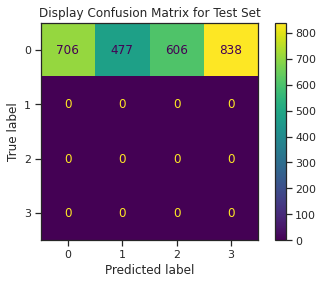

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      0.27      0.42      2627
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0

    accuracy                           0.27      2627
   macro avg       0.25      0.07      0.11      2627
weighted avg       1.00      0.27      0.42      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [130]:
# with actual lables
adaboost(trainset=train_transform.loc[:, 0:12], testset=test_transform.loc[:, 0:12])

In Train Set
		 Accuracy Score =  0.7566931085770947


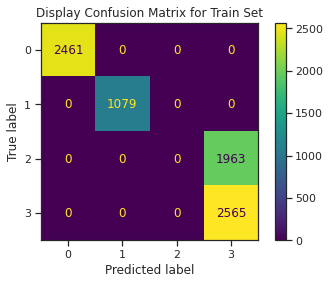

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00      2461
           1       1.00      1.00      1.00      1079
           2       0.00      0.00      0.00      1963
           3       0.57      1.00      0.72      2565

    accuracy                           0.76      8068
   macro avg       0.64      0.75      0.68      8068
weighted avg       0.62      0.76      0.67      8068

In Test Set
		 Accuracy Score =  0.7643700038066236


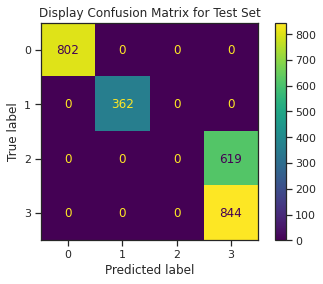

		 Classification Report =                precision    recall  f1-score   support

           0       1.00      1.00      1.00       802
           1       1.00      1.00      1.00       362
           2       0.00      0.00      0.00       619
           3       0.58      1.00      0.73       844

    accuracy                           0.76      2627
   macro avg       0.64      0.75      0.68      2627
weighted avg       0.63      0.76      0.68      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [131]:
# with Kmeans lables
adaboost(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
         trainClasess=train_transform['Segmentation K-PC1'], testClasses=test_transform['Segmentation K-PC1'])

In Train Set
		 Accuracy Score =  0.7492563212692117


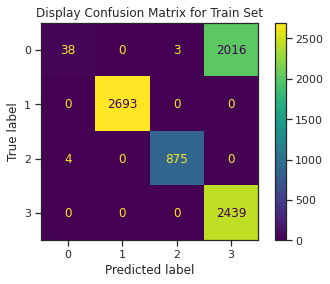

		 Classification Report =                precision    recall  f1-score   support

           0       0.90      0.02      0.04      2057
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00       879
           3       0.55      1.00      0.71      2439

    accuracy                           0.75      8068
   macro avg       0.86      0.75      0.68      8068
weighted avg       0.84      0.75      0.67      8068

In Test Set
		 Accuracy Score =  0.0


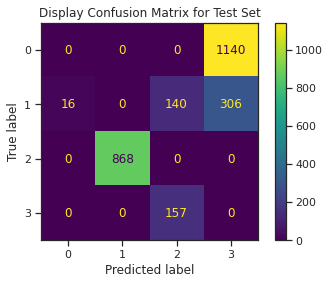

		 Classification Report =                precision    recall  f1-score   support

           0       0.00      0.00      0.00    1140.0
           1       0.00      0.00      0.00     462.0
           2       0.00      0.00      0.00     868.0
           3       0.00      0.00      0.00     157.0

    accuracy                           0.00    2627.0
   macro avg       0.00      0.00      0.00    2627.0
weighted avg       0.00      0.00      0.00    2627.0



AdaBoostClassifier(n_estimators=300, random_state=45)

In [132]:
# with Agglomerative lables
adaboost(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
         trainClasess=train_transform['Segmentation agg'], testClasses=test_transform['Segmentation agg'])

In Train Set
		 Accuracy Score =  0.7502478929102627


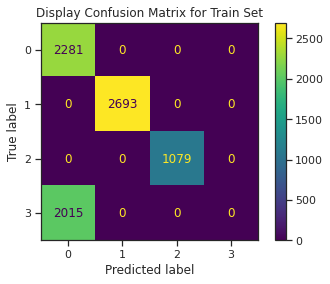

/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


		 Classification Report =                precision    recall  f1-score   support

           0       0.53      1.00      0.69      2281
           1       1.00      1.00      1.00      2693
           2       1.00      1.00      1.00      1079
           3       0.00      0.00      0.00      2015

    accuracy                           0.75      8068
   macro avg       0.63      0.75      0.67      8068
weighted avg       0.62      0.75      0.66      8068

In Test Set
		 Accuracy Score =  0.43357441948991243


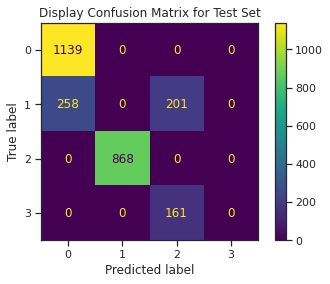

		 Classification Report =                precision    recall  f1-score   support

           0       0.82      1.00      0.90      1139
           1       0.00      0.00      0.00       459
           2       0.00      0.00      0.00       868
           3       0.00      0.00      0.00       161

    accuracy                           0.43      2627
   macro avg       0.20      0.25      0.22      2627
weighted avg       0.35      0.43      0.39      2627



/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/conda/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier(n_estimators=300, random_state=45)

In [133]:
# with Agglomerative lables
adaboost(trainset=np.array(train_transform.loc[:, 0]).reshape(-1, 1), testset=np.array(test_transform.loc[:, 0]).reshape(-1, 1),
         trainClasess=train_transform['Segmentation agg-PC1'], testClasses=test_transform['Segmentation agg-PC1'])

#### Observation
**Principal Components** perform well than orginal data in general.

**KMeans** with ***First PC*** is better than ***all PCs***.

**Agglomerative** perform well only in ***Ada Boost***.
